João Augusto Bottrel ----- RID468

O objetivo desse trabalho é criar um modelo a partir dos dados de 9000 clientes e seus comportamentos financeiros para disponibilizar uma futura função de crédito com maior eficiência para os atuais e futuros clientes. Para isso será feito duas modelagens, uma para criar rótulos (clusters) para os clientes agrupando-os em comportamentos similares e em seguida um modelo de regressão usando o limite de crédito como valor "target"

#1. Introdução

Segue bibliotecas que serão utilizadas para essa análise

In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture 
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, davies_bouldin_score,v_measure_score
from sklearn.model_selection   import train_test_split
from sklearn.neural_network    import MLPRegressor
from sklearn.metrics           import r2_score, mean_absolute_error,mean_squared_error
from sklearn.model_selection   import GridSearchCV
sns.set(rc={'figure.figsize':(5,7)})

Importação do dataset de clientes: fonte - https://www.kaggle.com/arjunbhasin2013/ccdata

In [2]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [3]:
path='/content/gdrive/MyDrive/Colab Notebooks/Bases/CC GENERAL.csv'
df=pd.read_csv(path)

Leitura inicial do dataset

In [4]:
df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


Abaixo segue o significado de cada coluna do dataset

* CUSTID : Identification of Credit Card holder (Categorical)
* BALANCE : Balance amount left in their account to make
purchases
* BALANCEFREQUENCY : How frequently the Balance is updated,
score between 0 and 1 (1 = frequently updated, 0 = not
frequently updated)
* PURCHASES : Amount of purchases made from account
* ONEOFFPURCHASES : Maximum purchase amount done in
one-go
* INSTALLMENTSPURCHASES : Amount of purchase done in
installment
* CASHADVANCE : Cash in advance given by the user
* PURCHASESFREQUENCY : How frequently the Purchases are
being made, score between 0 and 1 (1 = frequently purchased, 0
= not frequently purchased)
* ONEOFFPURCHASESFREQUENCY : How frequently Purchases
are happening in one-go (1 = frequently purchased, 0 = not
frequently purchased)
* PURCHASESINSTALLMENTSFREQUENCY : How frequently
purchases in installments are being done (1 = frequently done, 0
= not frequently done)
* CASHADVANCEFREQUENCY : How frequently the cash in
advance being paid
* CASHADVANCETRX : Number of Transactions made with "Cash
in Advanced"
* PURCHASESTRX : Numbe of purchase transactions made
* CREDITLIMIT : Limit of Credit Card for user
* PAYMENTS : Amount of Payment done by user
* MINIMUM_PAYMENTS : Minimum amount of payments made
by user
* PRCFULLPAYMENT : Percent of full payment paid by user
* TENURE : Tenure of credit card service for user

Verificação do formato de cada variável

In [5]:
df.dtypes

CUST_ID                              object
BALANCE                             float64
BALANCE_FREQUENCY                   float64
PURCHASES                           float64
ONEOFF_PURCHASES                    float64
INSTALLMENTS_PURCHASES              float64
CASH_ADVANCE                        float64
PURCHASES_FREQUENCY                 float64
ONEOFF_PURCHASES_FREQUENCY          float64
PURCHASES_INSTALLMENTS_FREQUENCY    float64
CASH_ADVANCE_FREQUENCY              float64
CASH_ADVANCE_TRX                      int64
PURCHASES_TRX                         int64
CREDIT_LIMIT                        float64
PAYMENTS                            float64
MINIMUM_PAYMENTS                    float64
PRC_FULL_PAYMENT                    float64
TENURE                                int64
dtype: object

Descrição estatística básica de cada variável

In [6]:
df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


A feature 'CUST_ID' será removida, pois ela é uma chave de cada usuário e não agrega nos *modelos*

In [7]:
df.drop('CUST_ID',axis=1,inplace=True)

Uma verificação de nulos é feita e em seguida esses valores serão substituídos pelo valor mínimo

In [8]:
df.isnull().sum()

BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [9]:
#Substituir os nulos pelo minimo
features = df.columns[0:]
n = len(features)
for i in range(0,n):
  column = features[i]
  df[column].fillna(df[column].min(),inplace=True)

Abaixo será feito uma remoção de outliers, mantendo somente o que está abaixo dos 95% dos dados, evitando dados discrepantes que podem distorcer o modelo

In [10]:
#removendo outiliers mantendo somente o que está abaixo de 95% da distribuição
features_outliers = ['BALANCE','PURCHASES','MINIMUM_PAYMENTS','PAYMENTS','CREDIT_LIMIT','PURCHASES_TRX','ONEOFF_PURCHASES','CASH_ADVANCE','CASH_ADVANCE_TRX']
n_outliers = len(features_outliers)
for i in range(0,n_outliers):
  column = features_outliers[i]
  q95 = df[column].quantile(0.95)
  df[column] = df[column][df[column]<q95]

É feito uma nova verificação e remoção de nulos para remover os resíduos do filtro feito acima

In [11]:
df.isnull().sum()

BALANCE                             448
BALANCE_FREQUENCY                     0
PURCHASES                           448
ONEOFF_PURCHASES                    448
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                        448
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                    470
PURCHASES_TRX                       452
CREDIT_LIMIT                        460
PAYMENTS                            448
MINIMUM_PAYMENTS                    448
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

In [12]:
df = df.dropna()

In [13]:
df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000,6880.000000
mean,995.151694,0.857780,579.426174,300.337948,279.366419,500.025960,0.469246,0.162995,0.346478,0.100031,1.823547,9.750872,3456.202556,974.664002,410.897522,0.153512,11.468750
std,1190.965770,0.252570,721.139243,517.630795,452.429074,902.031092,0.391970,0.261136,0.386524,0.152807,2.995315,11.296587,2465.720075,974.757099,443.575376,0.290509,1.404998
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,75.973734,0.818182,41.400000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1500.000000,320.166113,145.768171,0.000000,12.000000
50%,547.868765,1.000000,308.190000,0.000000,76.430000,0.000000,0.416667,0.000000,0.166667,0.000000,0.000000,6.000000,2700.000000,651.613201,218.279833,0.000000,12.000000
75%,1462.396758,1.000000,832.010000,395.012500,387.702500,650.349033,0.916667,0.250000,0.750000,0.166667,3.000000,13.000000,5000.000000,1298.660032,531.724151,0.166667,12.000000
max,5906.184924,1.000000,3986.240000,2655.990000,3927.120000,4639.195255,1.000000,1.000000,1.000000,1.166667,14.000000,56.000000,11500.000000,6043.227704,2707.521979,1.000000,12.000000


Clonando o dataframe final

In [14]:
dff = df.copy()

#2. EDA - Análise Exploratória dos Dados

Abaixo iremos gerar um gráfico de distribuição da frequência de cada coluna do dataset (histograma)

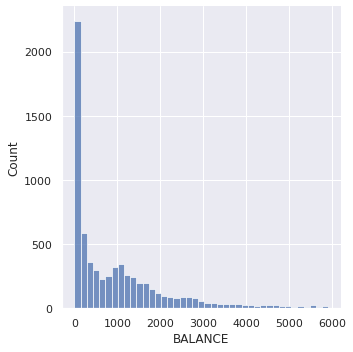

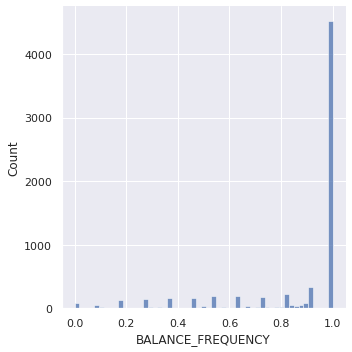

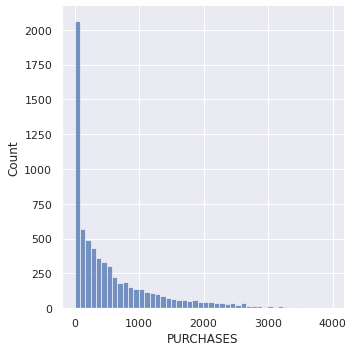

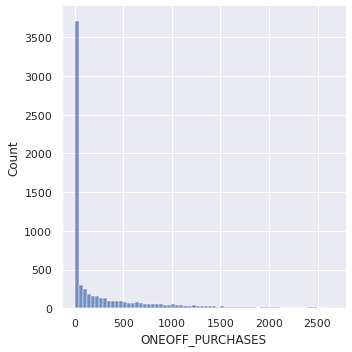

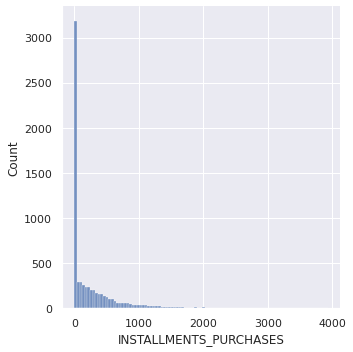

...

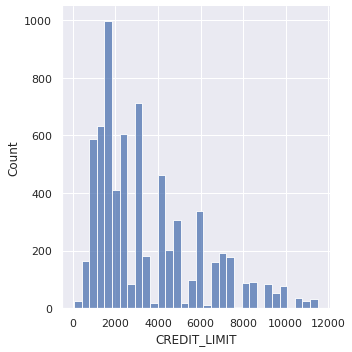

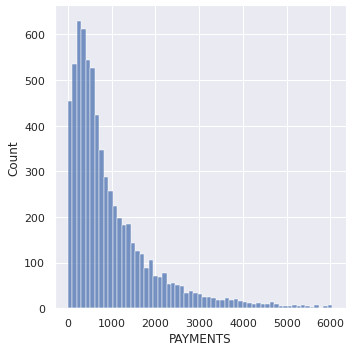

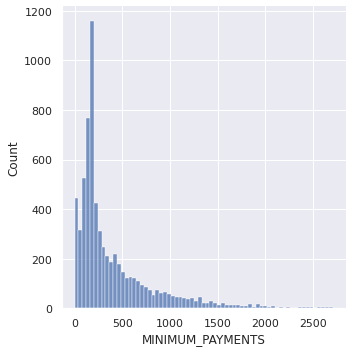

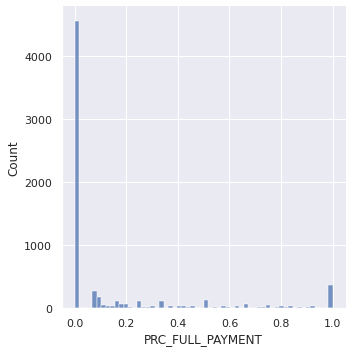

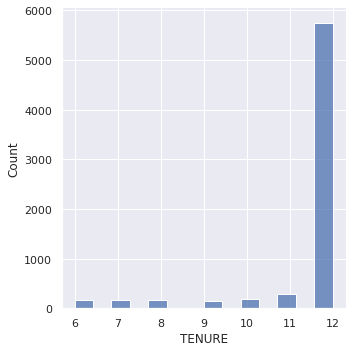

In [15]:
for i in range(0,n):
  sns.displot(x=features[i],data=df)
  plt.show()

Também é interessante verificar correlações entre as variáveis

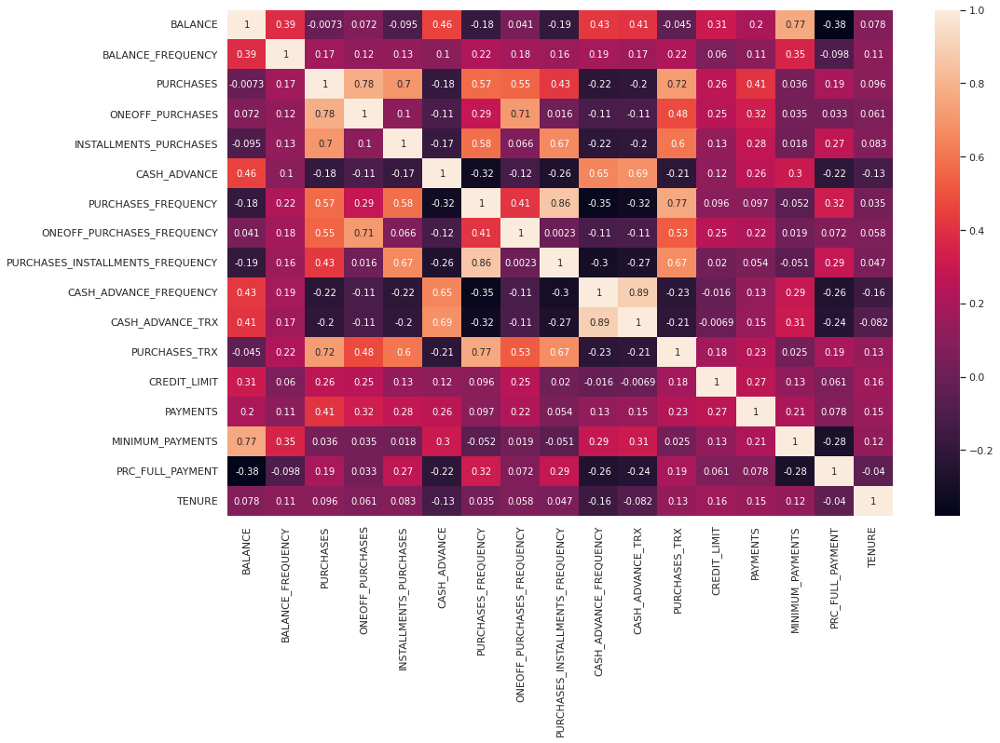

In [16]:
plt.figure(figsize=(16,10))
sns.heatmap(df.corr(),annot=True)

Abaixo iremos transformar as variáveis usando um *scaler* para normalizar os dados para retirar o impacto da grandeza de cada variável

In [17]:
scaler = StandardScaler()
scaler.fit(df)

df_scaled = scaler.transform(df)

# Transformanda para dataframe para visualização
df = pd.DataFrame(df_scaled,columns = df.columns)

In [18]:
df.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03,6.880000e+03
mean,2.499938e-16,3.502447e-15,2.193013e-17,3.112142e-15,1.810890e-16,1.462291e-15,-6.706038e-16,7.624134e-15,4.681010e-16,-1.472014e-16,-5.398500e-16,5.325198e-18,-3.875292e-16,-4.619044e-16,-4.578702e-16,-4.058430e-15,4.187477e-15
std,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00,1.000073e+00
min,-8.356445e-01,-3.396453e+00,-8.035456e-01,-5.802587e-01,-6.175260e-01,-5.543737e-01,-1.197235e+00,-6.242230e-01,-8.964594e-01,-6.546679e-01,-6.088438e-01,-8.632325e-01,-1.381523e+00,-9.999772e-01,-9.263549e-01,-5.284608e-01,-3.892637e+00
25%,-7.718482e-01,-1.567914e-01,-7.461323e-01,-5.802587e-01,-6.175260e-01,-5.543737e-01,-9.846190e-01,-6.242230e-01,-8.964594e-01,-6.546679e-01,-6.088438e-01,-7.747037e-01,-7.934172e-01,-6.714960e-01,-5.977532e-01,-5.284608e-01,3.781419e-01
50%,-3.755905e-01,5.631326e-01,-3.761491e-01,-5.802587e-01,-4.485812e-01,-5.543737e-01,-1.341498e-01,-6.242230e-01,-4.652339e-01,-6.546679e-01,-6.088438e-01,-3.320600e-01,-3.067086e-01,-3.314408e-01,-4.342705e-01,-5.284608e-01,3.781419e-01
75%,3.923530e-01,5.631326e-01,3.502821e-01,1.829131e-01,2.394717e-01,1.666617e-01,1.141552e+00,3.332007e-01,1.044052e+00,4.361129e-01,3.927931e-01,2.876412e-01,6.261496e-01,3.324106e-01,2.724123e-01,4.528708e-02,3.781419e-01
max,4.123872e+00,5.631326e-01,4.724554e+00,4.551165e+00,8.063184e+00,4.589055e+00,1.354168e+00,3.205472e+00,1.690889e+00,6.980785e+00,4.065462e+00,4.094377e+00,3.262488e+00,5.200200e+00,5.177906e+00,2.914020e+00,3.781419e-01


#3. Aplicação do modelo de clusterização

Abaixo usaremos dois modelos para escolher o melhor modelo de clusterização.
* O método de Elbow (referência: https://www.kdnuggets.com/2019/10/clustering-metrics-better-elbow-method.html)
* O método de silhueta (https://vitalflux.com/elbow-method-silhouette-score-which-better/)

Método elbow

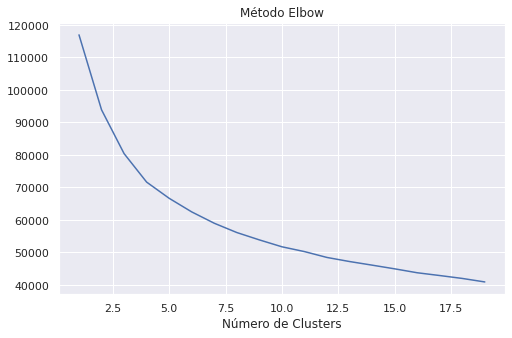

In [19]:
plt.figure(figsize=(8,5))
elbow = []
for i in range(1, 20):
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=42)
    kmeans.fit(df)
    elbow.append(kmeans.inertia_)
plt.plot(range(1, 20), elbow)
plt.title('Método Elbow')
plt.xlabel('Número de Clusters')
plt.show()

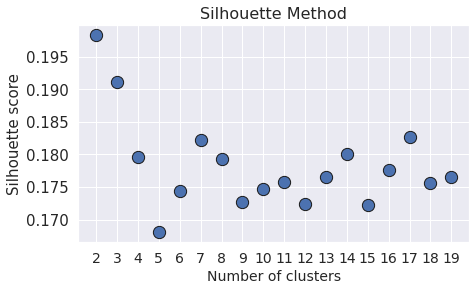

In [20]:
alvo = df
max = 20
km_scores= []
km_silhouette = []
vmeasure_score =[]
db_score = []
gm_bic= []
gm_score=[]
for i in range(2,max):
    km = KMeans(n_clusters=i, random_state=42).fit(alvo)
    preds = km.predict(alvo)
    
    km_scores.append(-km.score(alvo))
    
    silhouette = silhouette_score(alvo,preds)
    km_silhouette.append(silhouette)

# Plotagem do método da Silhouette (Silhueta)
plt.figure(figsize=(7,4))
plt.title("Silhouette Method",fontsize=16)
plt.scatter(x=[i for i in range(2,max)],y=km_silhouette,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Number of clusters",fontsize=14)
plt.ylabel("Silhouette score",fontsize=15)
plt.xticks([i for i in range(2,max)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

Pelos dois modelos podemos estimar um k ótimo de 4. Abaixo aplicaremos o método de Mistura Gaussiana para gerar os 4 clusters (https://towardsdatascience.com/gaussian-mixture-models-explained-6986aaf5a95#:~:text=A%20Gaussian%20Mixture%20is%20a,Σ%20that%20defines%20its%20width.)

O cluster determinado já é incluso no dataset tratado, com uma contagem de quantos clientes ficaram em cada cluster.

In [21]:
k = 4
gm = GaussianMixture(k)
df['cluster'] = gm.fit_predict(df[features]).astype('str')

In [22]:
df.cluster.value_counts()

0    2501
3    1873
1    1703
2     803
Name: cluster, dtype: int64

Abaixo podemos comparar como cada cluster se distribui para cada variável usando o método do bloxplot

Boxplot Feature BALANCE


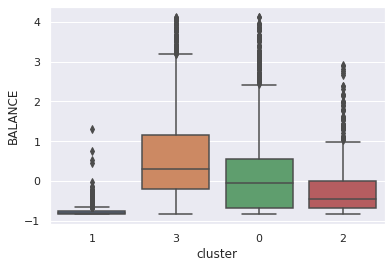

Boxplot Feature BALANCE_FREQUENCY


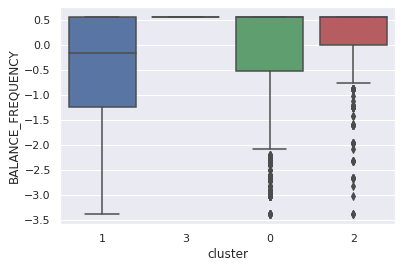

Boxplot Feature PURCHASES


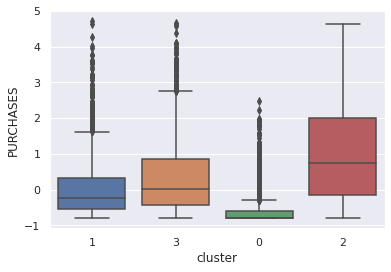

Boxplot Feature ONEOFF_PURCHASES


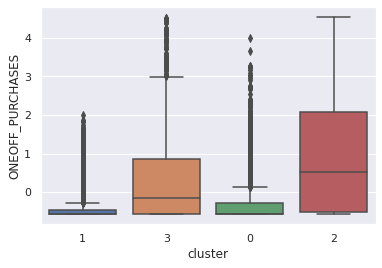

Boxplot Feature INSTALLMENTS_PURCHASES


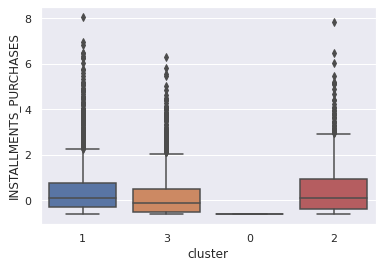

Boxplot Feature CASH_ADVANCE


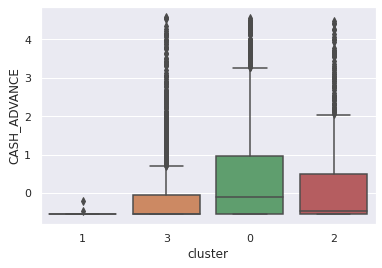

Boxplot Feature PURCHASES_FREQUENCY


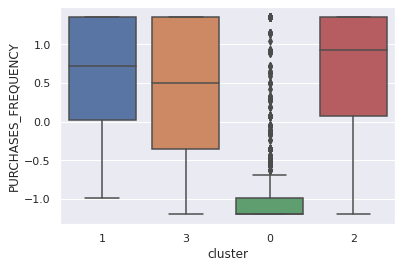

Boxplot Feature ONEOFF_PURCHASES_FREQUENCY


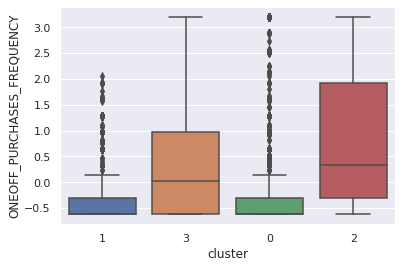

Boxplot Feature PURCHASES_INSTALLMENTS_FREQUENCY


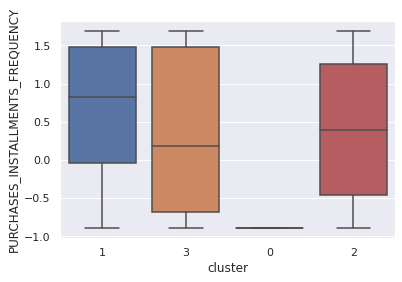

Boxplot Feature CASH_ADVANCE_FREQUENCY


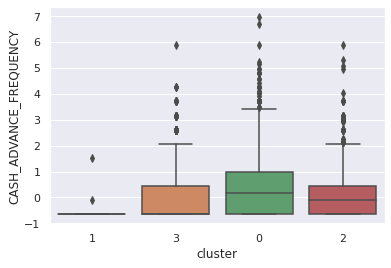

Boxplot Feature CASH_ADVANCE_TRX


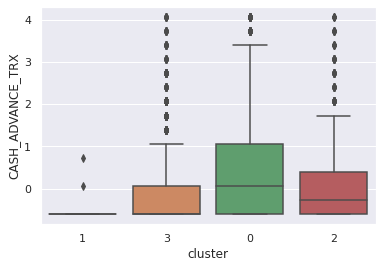

Boxplot Feature PURCHASES_TRX


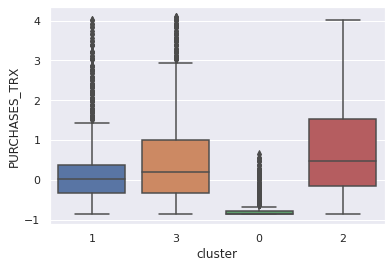

Boxplot Feature CREDIT_LIMIT


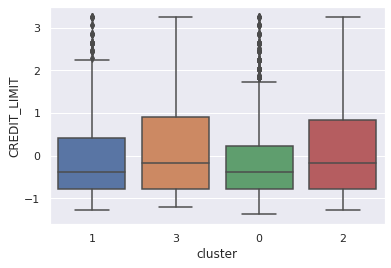

Boxplot Feature PAYMENTS


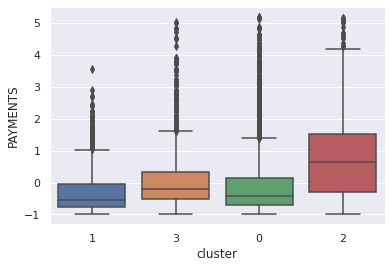

Boxplot Feature MINIMUM_PAYMENTS


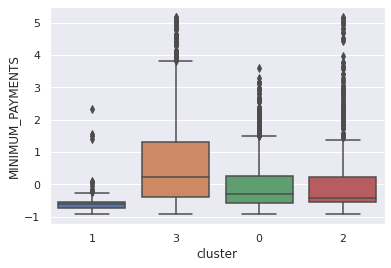

Boxplot Feature PRC_FULL_PAYMENT


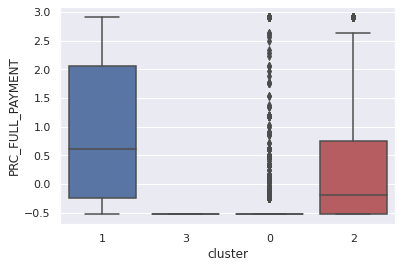

Boxplot Feature TENURE


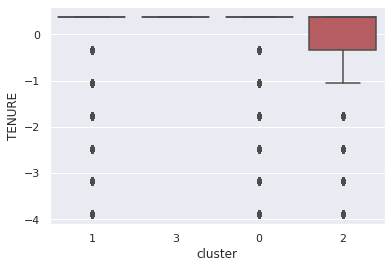

In [23]:
for i in range(0,n):
  print('Boxplot Feature %s'%(features[i]))
  sns.boxplot(x ='cluster', y = features[i],data = df)
  plt.show()

As dispersões abaixo são combinações de duas em duas variáveis com uma coloração diferente para cada cluster

Dispersão da feature BALANCE com BALANCE_FREQUENCY


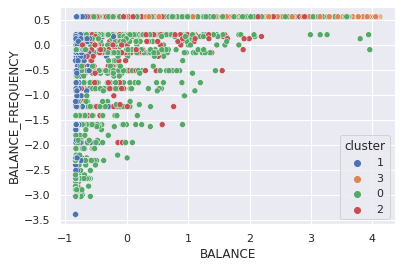

Dispersão da feature BALANCE com PURCHASES


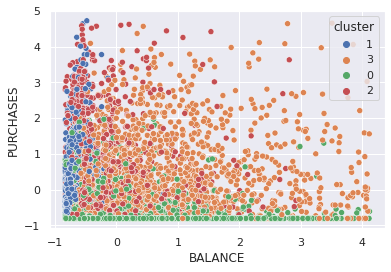

Dispersão da feature BALANCE com ONEOFF_PURCHASES


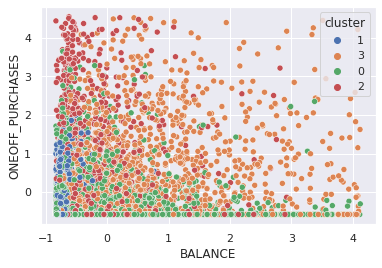

Dispersão da feature BALANCE com INSTALLMENTS_PURCHASES


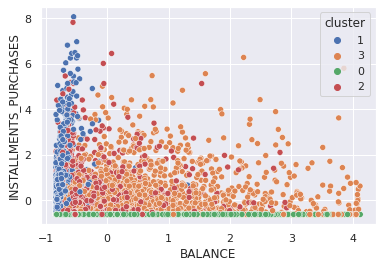

Dispersão da feature BALANCE com CASH_ADVANCE


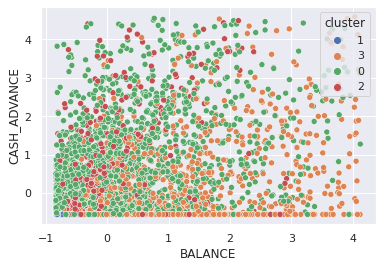

Dispersão da feature BALANCE com PURCHASES_FREQUENCY


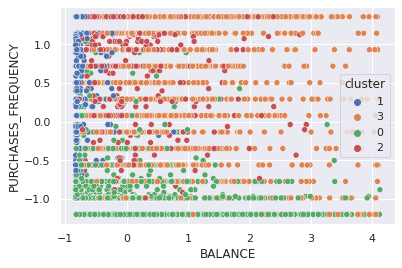

Dispersão da feature BALANCE com ONEOFF_PURCHASES_FREQUENCY


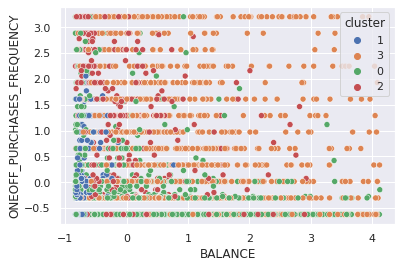

Dispersão da feature BALANCE com PURCHASES_INSTALLMENTS_FREQUENCY


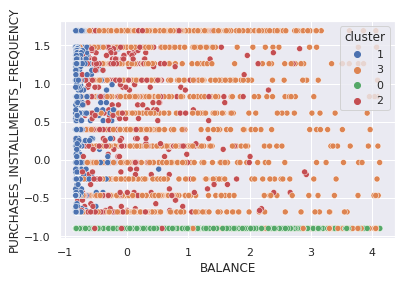

Dispersão da feature BALANCE com CASH_ADVANCE_FREQUENCY


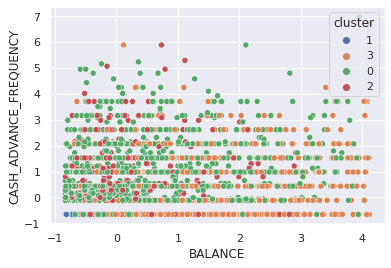

Dispersão da feature BALANCE com CASH_ADVANCE_TRX


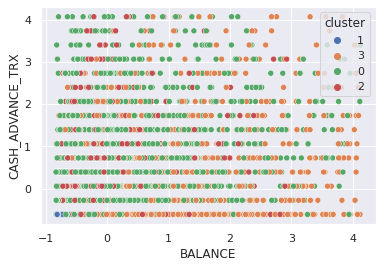

Dispersão da feature BALANCE com PURCHASES_TRX


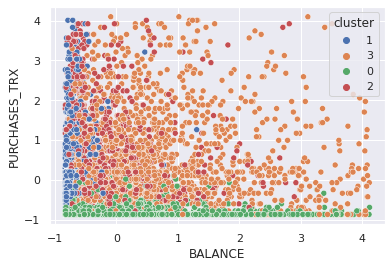

Dispersão da feature BALANCE com CREDIT_LIMIT


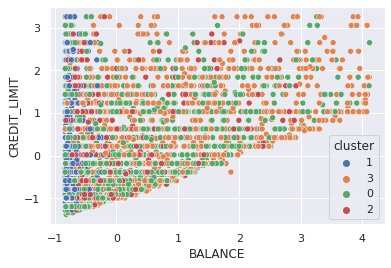

Dispersão da feature BALANCE com PAYMENTS


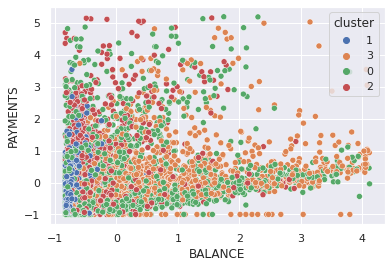

Dispersão da feature BALANCE com MINIMUM_PAYMENTS


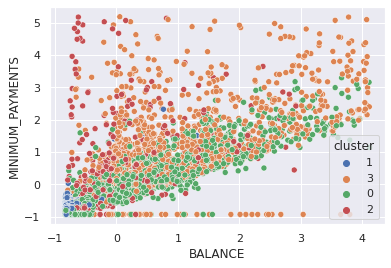

Dispersão da feature BALANCE com PRC_FULL_PAYMENT


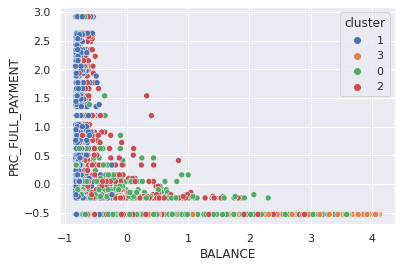

Dispersão da feature BALANCE com TENURE


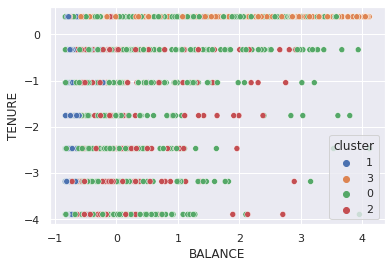

Dispersão da feature BALANCE_FREQUENCY com BALANCE


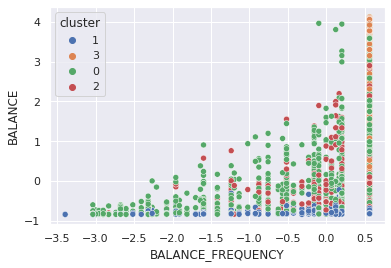

Dispersão da feature BALANCE_FREQUENCY com PURCHASES


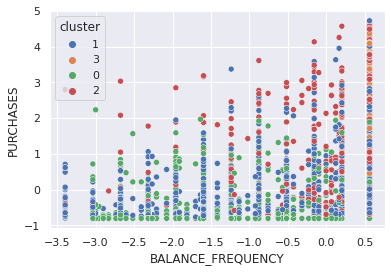

Dispersão da feature BALANCE_FREQUENCY com ONEOFF_PURCHASES


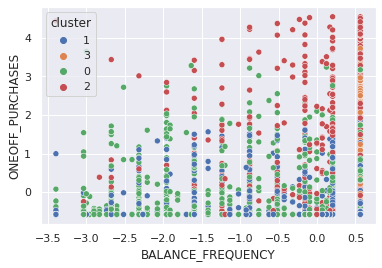

Dispersão da feature BALANCE_FREQUENCY com INSTALLMENTS_PURCHASES


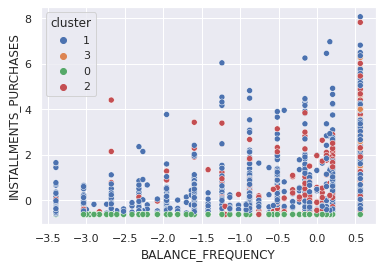

Dispersão da feature BALANCE_FREQUENCY com CASH_ADVANCE


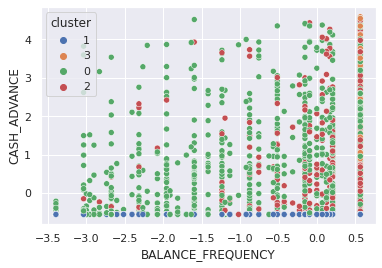

Dispersão da feature BALANCE_FREQUENCY com PURCHASES_FREQUENCY


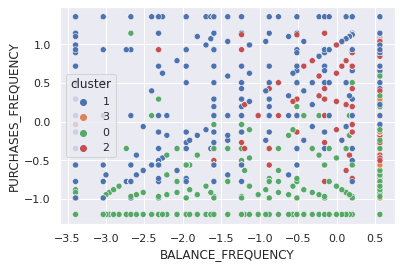

Dispersão da feature BALANCE_FREQUENCY com ONEOFF_PURCHASES_FREQUENCY


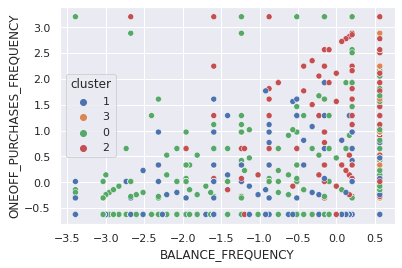

Dispersão da feature BALANCE_FREQUENCY com PURCHASES_INSTALLMENTS_FREQUENCY


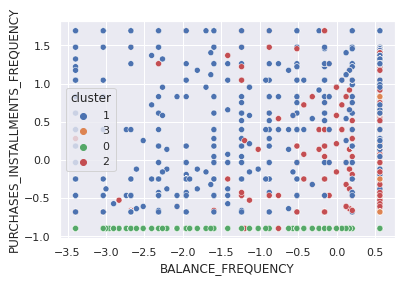

Dispersão da feature BALANCE_FREQUENCY com CASH_ADVANCE_FREQUENCY


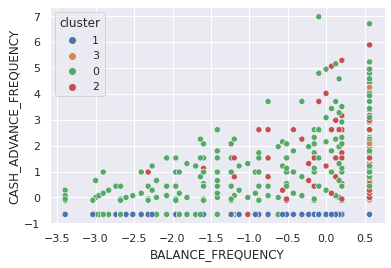

Dispersão da feature BALANCE_FREQUENCY com CASH_ADVANCE_TRX


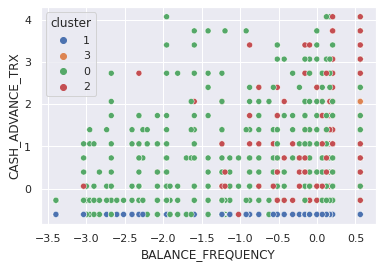

Dispersão da feature BALANCE_FREQUENCY com PURCHASES_TRX


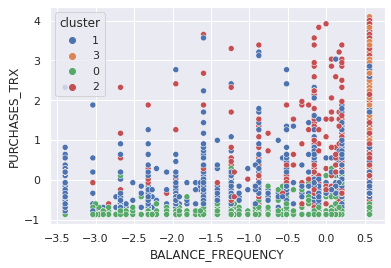

Dispersão da feature BALANCE_FREQUENCY com CREDIT_LIMIT


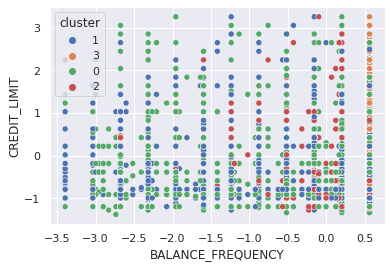

Dispersão da feature BALANCE_FREQUENCY com PAYMENTS


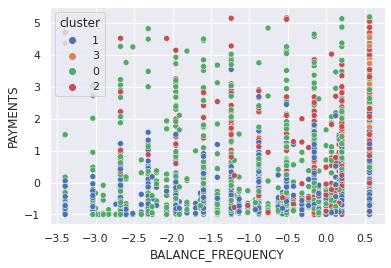

Dispersão da feature BALANCE_FREQUENCY com MINIMUM_PAYMENTS


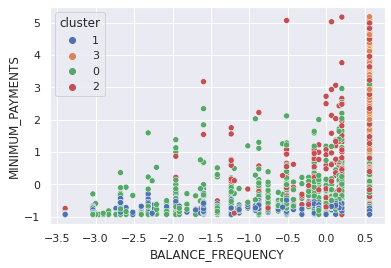

Dispersão da feature BALANCE_FREQUENCY com PRC_FULL_PAYMENT


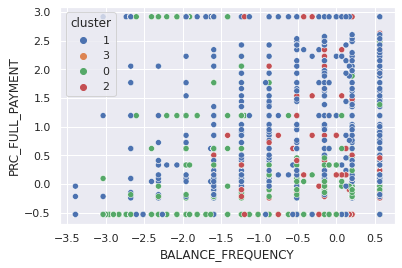

Dispersão da feature BALANCE_FREQUENCY com TENURE


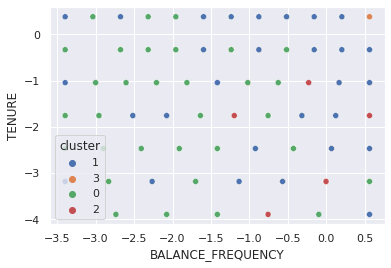

Dispersão da feature PURCHASES com BALANCE


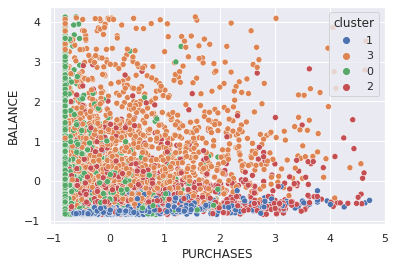

Dispersão da feature PURCHASES com BALANCE_FREQUENCY


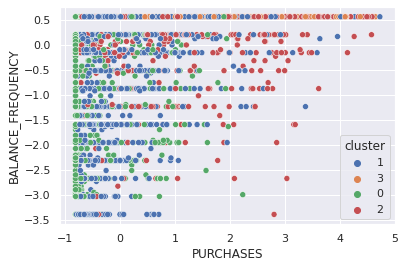

Dispersão da feature PURCHASES com ONEOFF_PURCHASES


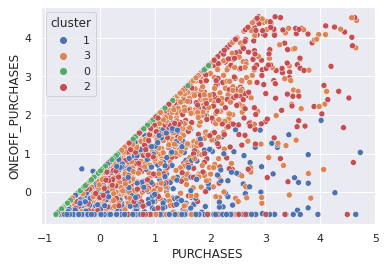

Dispersão da feature PURCHASES com INSTALLMENTS_PURCHASES


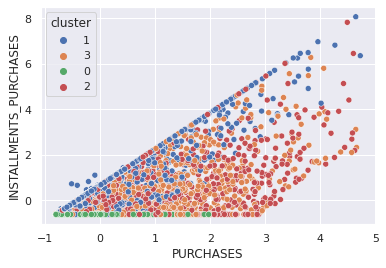

Dispersão da feature PURCHASES com CASH_ADVANCE


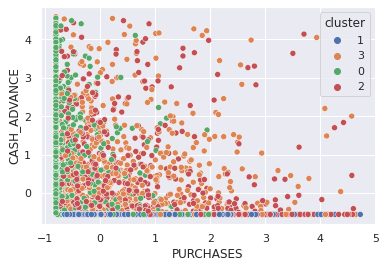

Dispersão da feature PURCHASES com PURCHASES_FREQUENCY


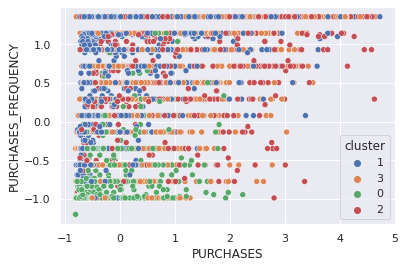

Dispersão da feature PURCHASES com ONEOFF_PURCHASES_FREQUENCY


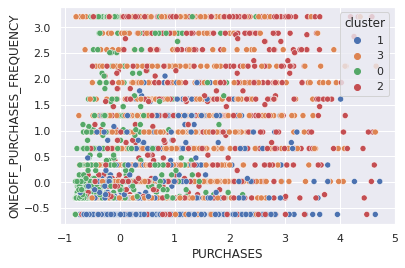

Dispersão da feature PURCHASES com PURCHASES_INSTALLMENTS_FREQUENCY


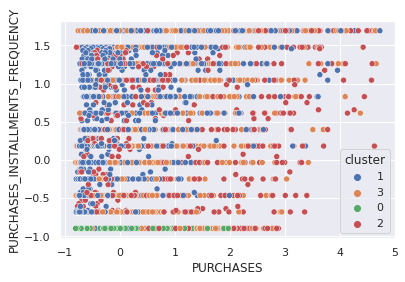

Dispersão da feature PURCHASES com CASH_ADVANCE_FREQUENCY


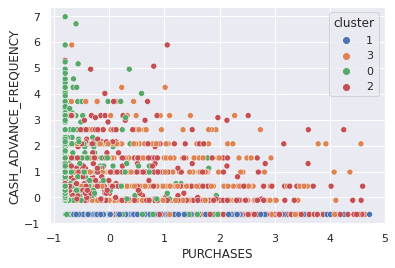

Dispersão da feature PURCHASES com CASH_ADVANCE_TRX


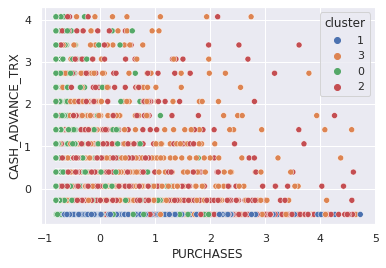

Dispersão da feature PURCHASES com PURCHASES_TRX


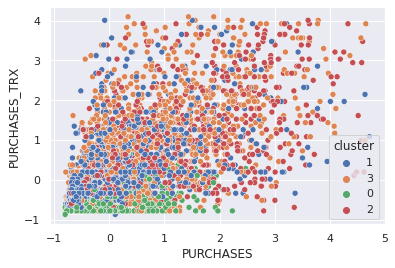

Dispersão da feature PURCHASES com CREDIT_LIMIT


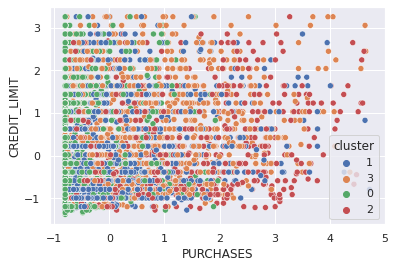

Dispersão da feature PURCHASES com PAYMENTS


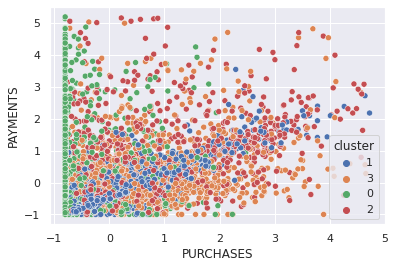

Dispersão da feature PURCHASES com MINIMUM_PAYMENTS


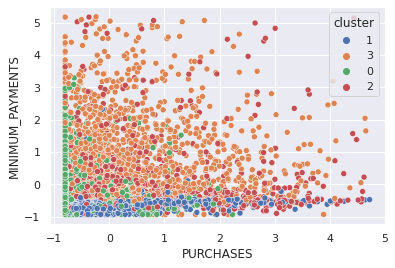

Dispersão da feature PURCHASES com PRC_FULL_PAYMENT


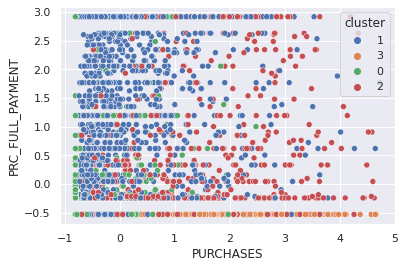

Dispersão da feature PURCHASES com TENURE


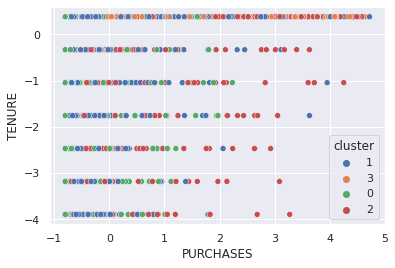

Dispersão da feature ONEOFF_PURCHASES com BALANCE


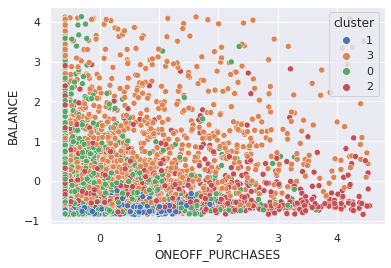

Dispersão da feature ONEOFF_PURCHASES com BALANCE_FREQUENCY


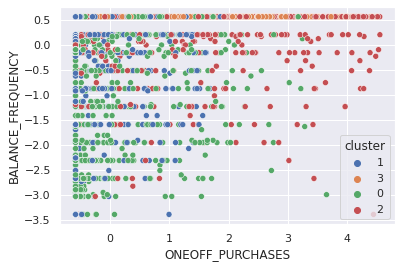

Dispersão da feature ONEOFF_PURCHASES com PURCHASES


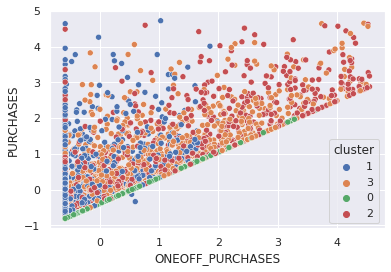

Dispersão da feature ONEOFF_PURCHASES com INSTALLMENTS_PURCHASES


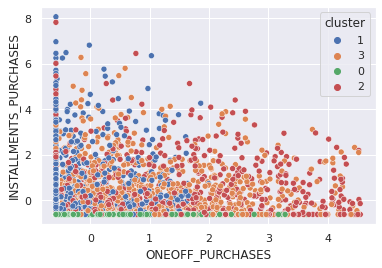

Dispersão da feature ONEOFF_PURCHASES com CASH_ADVANCE


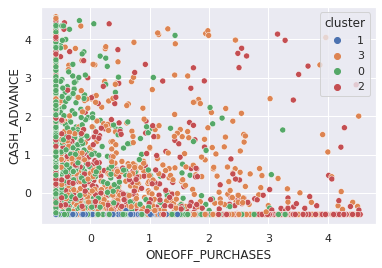

Dispersão da feature ONEOFF_PURCHASES com PURCHASES_FREQUENCY


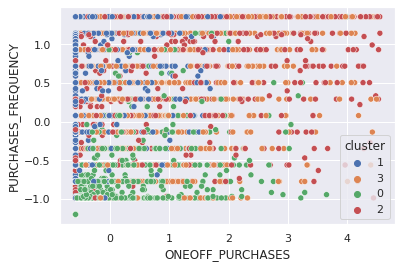

Dispersão da feature ONEOFF_PURCHASES com ONEOFF_PURCHASES_FREQUENCY


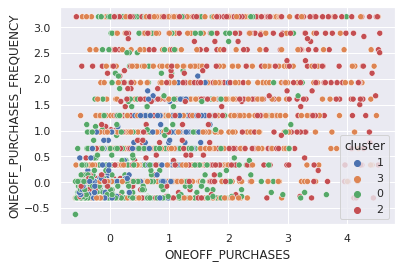

Dispersão da feature ONEOFF_PURCHASES com PURCHASES_INSTALLMENTS_FREQUENCY


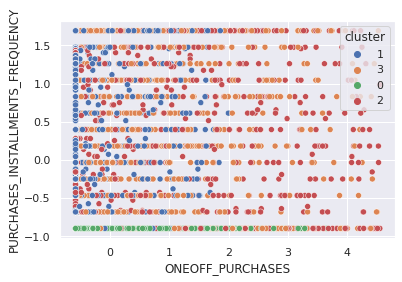

Dispersão da feature ONEOFF_PURCHASES com CASH_ADVANCE_FREQUENCY


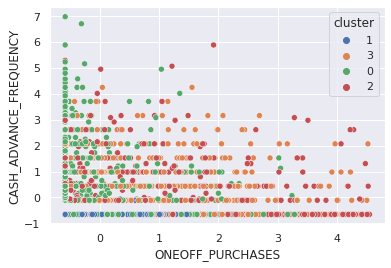

Dispersão da feature ONEOFF_PURCHASES com CASH_ADVANCE_TRX


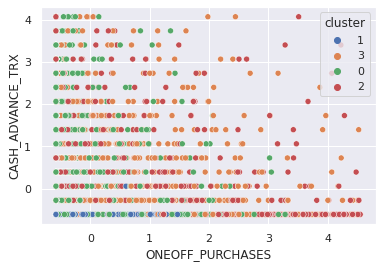

Dispersão da feature ONEOFF_PURCHASES com PURCHASES_TRX


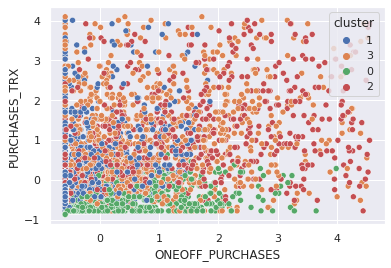

Dispersão da feature ONEOFF_PURCHASES com CREDIT_LIMIT


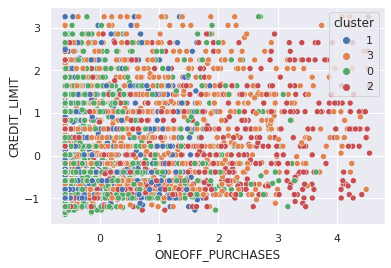

Dispersão da feature ONEOFF_PURCHASES com PAYMENTS


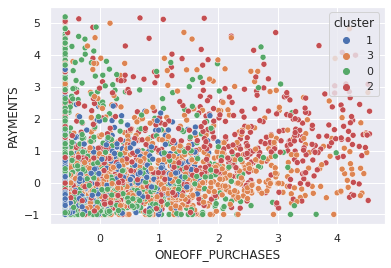

Dispersão da feature ONEOFF_PURCHASES com MINIMUM_PAYMENTS


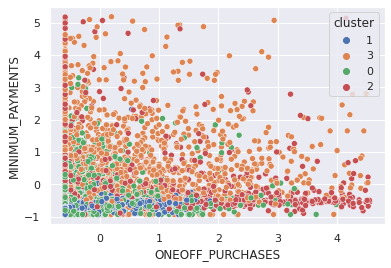

Dispersão da feature ONEOFF_PURCHASES com PRC_FULL_PAYMENT


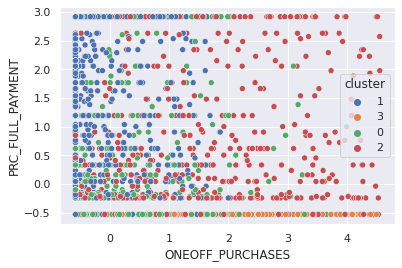

Dispersão da feature ONEOFF_PURCHASES com TENURE


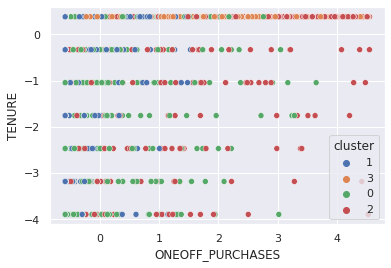

Dispersão da feature INSTALLMENTS_PURCHASES com BALANCE


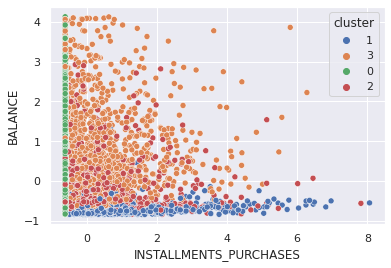

Dispersão da feature INSTALLMENTS_PURCHASES com BALANCE_FREQUENCY


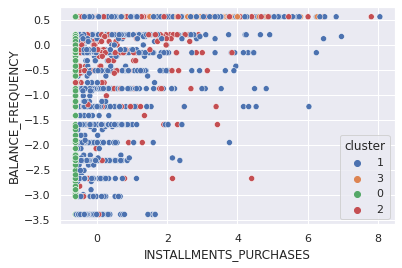

Dispersão da feature INSTALLMENTS_PURCHASES com PURCHASES


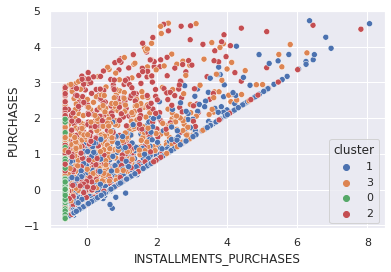

Dispersão da feature INSTALLMENTS_PURCHASES com ONEOFF_PURCHASES


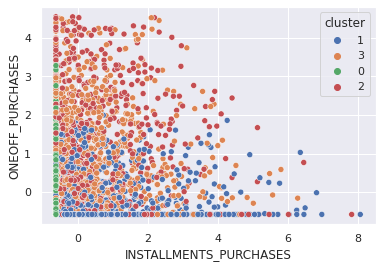

Dispersão da feature INSTALLMENTS_PURCHASES com CASH_ADVANCE


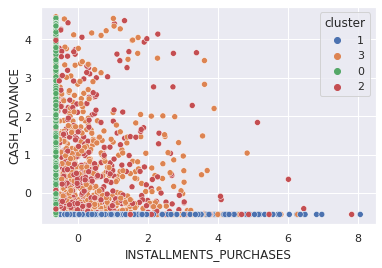

Dispersão da feature INSTALLMENTS_PURCHASES com PURCHASES_FREQUENCY


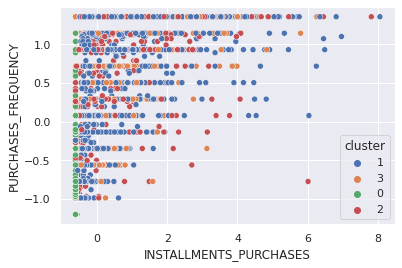

Dispersão da feature INSTALLMENTS_PURCHASES com ONEOFF_PURCHASES_FREQUENCY


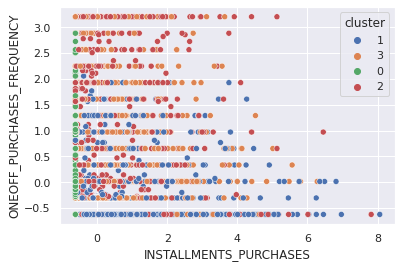

Dispersão da feature INSTALLMENTS_PURCHASES com PURCHASES_INSTALLMENTS_FREQUENCY


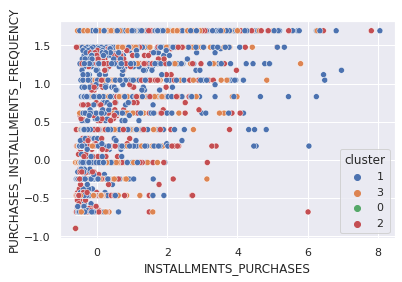

Dispersão da feature INSTALLMENTS_PURCHASES com CASH_ADVANCE_FREQUENCY


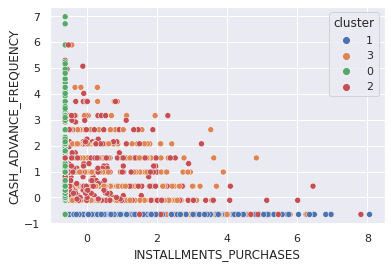

Dispersão da feature INSTALLMENTS_PURCHASES com CASH_ADVANCE_TRX


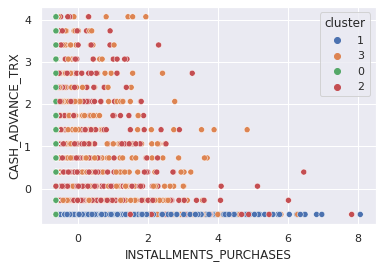

Dispersão da feature INSTALLMENTS_PURCHASES com PURCHASES_TRX


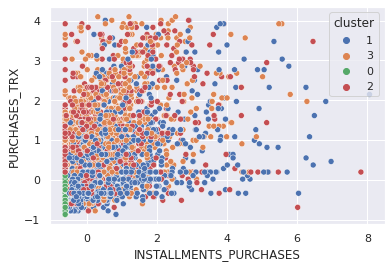

Dispersão da feature INSTALLMENTS_PURCHASES com CREDIT_LIMIT


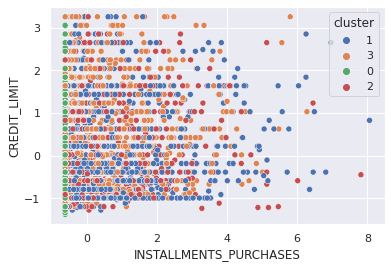

Dispersão da feature INSTALLMENTS_PURCHASES com PAYMENTS


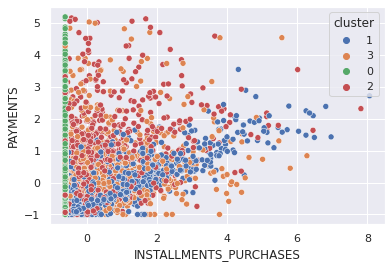

Dispersão da feature INSTALLMENTS_PURCHASES com MINIMUM_PAYMENTS


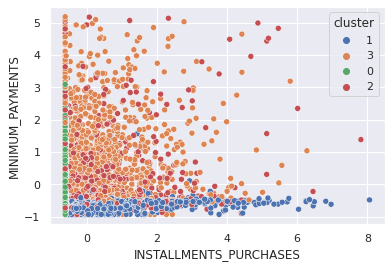

Dispersão da feature INSTALLMENTS_PURCHASES com PRC_FULL_PAYMENT


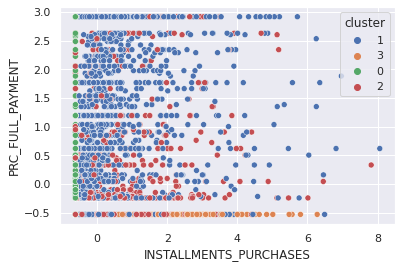

Dispersão da feature INSTALLMENTS_PURCHASES com TENURE


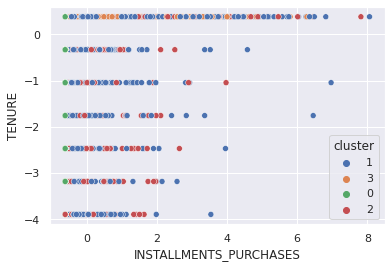

Dispersão da feature CASH_ADVANCE com BALANCE


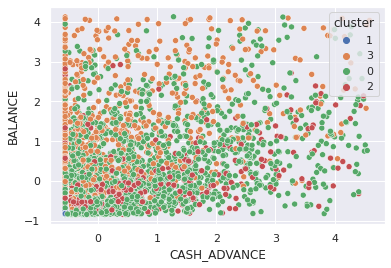

Dispersão da feature CASH_ADVANCE com BALANCE_FREQUENCY


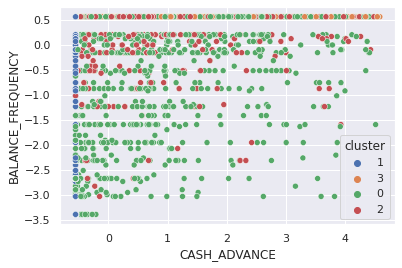

Dispersão da feature CASH_ADVANCE com PURCHASES


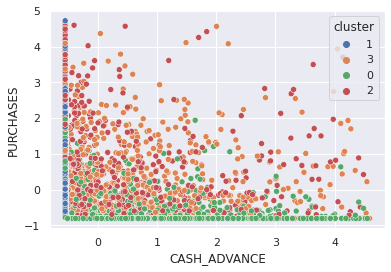

Dispersão da feature CASH_ADVANCE com ONEOFF_PURCHASES


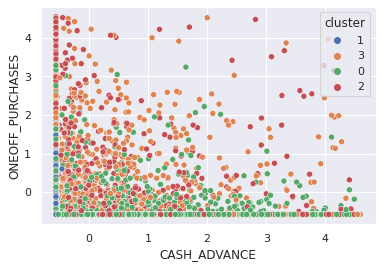

Dispersão da feature CASH_ADVANCE com INSTALLMENTS_PURCHASES


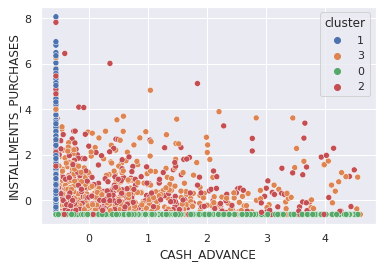

Dispersão da feature CASH_ADVANCE com PURCHASES_FREQUENCY


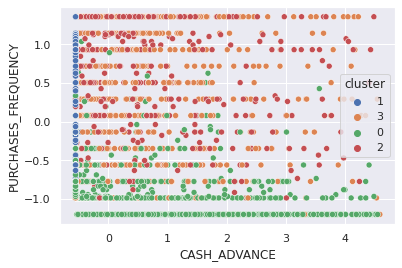

Dispersão da feature CASH_ADVANCE com ONEOFF_PURCHASES_FREQUENCY


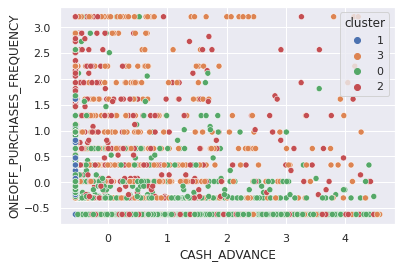

Dispersão da feature CASH_ADVANCE com PURCHASES_INSTALLMENTS_FREQUENCY


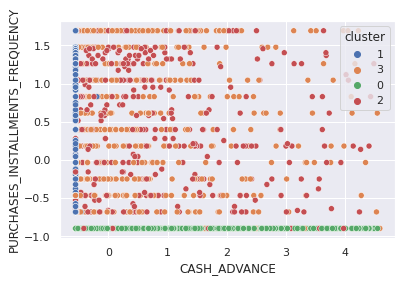

Dispersão da feature CASH_ADVANCE com CASH_ADVANCE_FREQUENCY


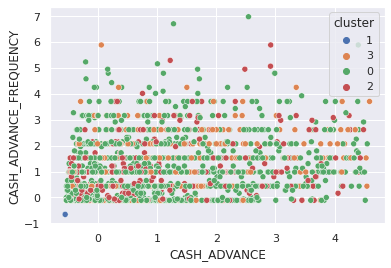

Dispersão da feature CASH_ADVANCE com CASH_ADVANCE_TRX


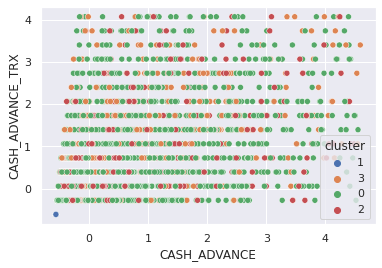

Dispersão da feature CASH_ADVANCE com PURCHASES_TRX


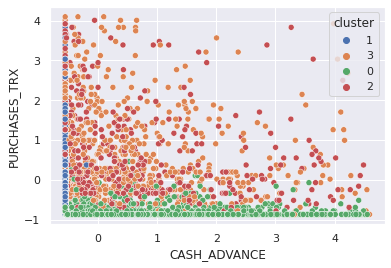

Dispersão da feature CASH_ADVANCE com CREDIT_LIMIT


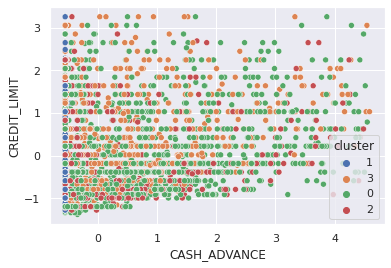

Dispersão da feature CASH_ADVANCE com PAYMENTS


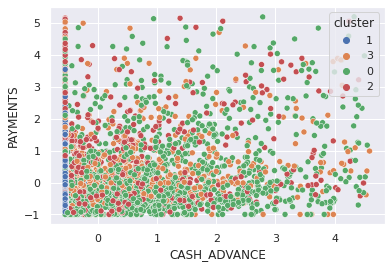

Dispersão da feature CASH_ADVANCE com MINIMUM_PAYMENTS


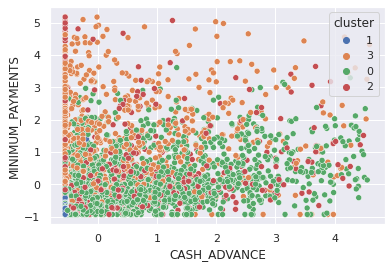

Dispersão da feature CASH_ADVANCE com PRC_FULL_PAYMENT


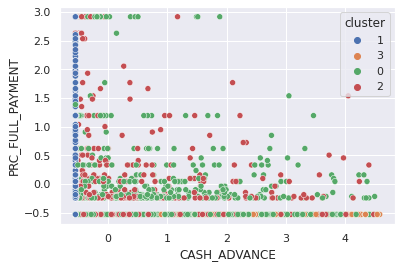

Dispersão da feature CASH_ADVANCE com TENURE


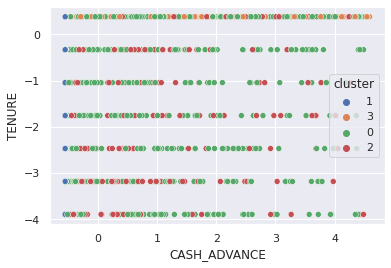

Dispersão da feature PURCHASES_FREQUENCY com BALANCE


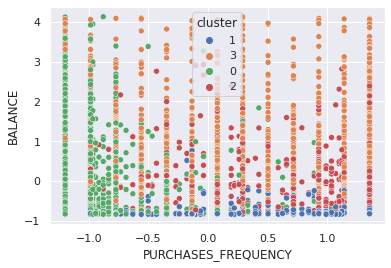

Dispersão da feature PURCHASES_FREQUENCY com BALANCE_FREQUENCY


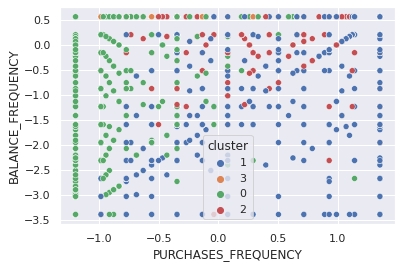

Dispersão da feature PURCHASES_FREQUENCY com PURCHASES


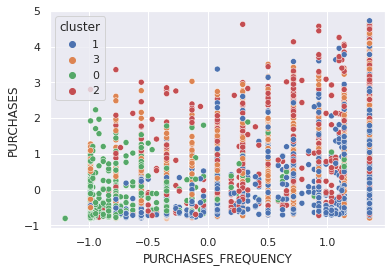

Dispersão da feature PURCHASES_FREQUENCY com ONEOFF_PURCHASES


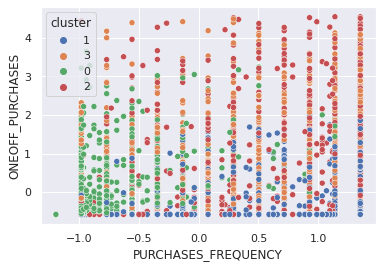

Dispersão da feature PURCHASES_FREQUENCY com INSTALLMENTS_PURCHASES


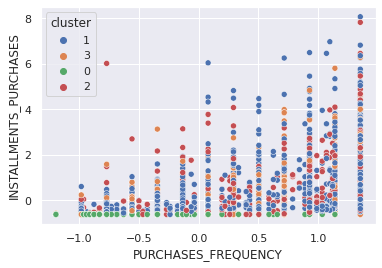

Dispersão da feature PURCHASES_FREQUENCY com CASH_ADVANCE


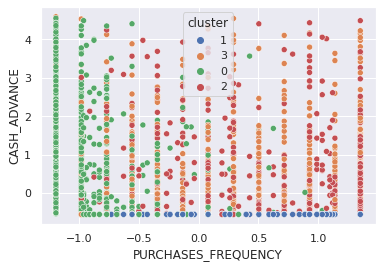

Dispersão da feature PURCHASES_FREQUENCY com ONEOFF_PURCHASES_FREQUENCY


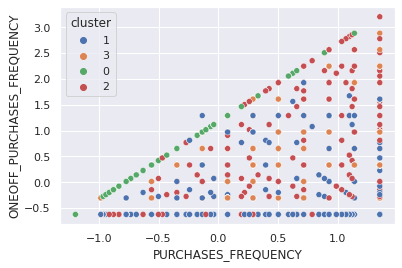

Dispersão da feature PURCHASES_FREQUENCY com PURCHASES_INSTALLMENTS_FREQUENCY


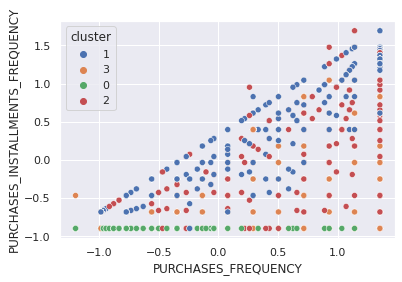

Dispersão da feature PURCHASES_FREQUENCY com CASH_ADVANCE_FREQUENCY


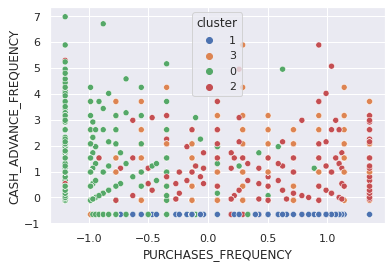

Dispersão da feature PURCHASES_FREQUENCY com CASH_ADVANCE_TRX


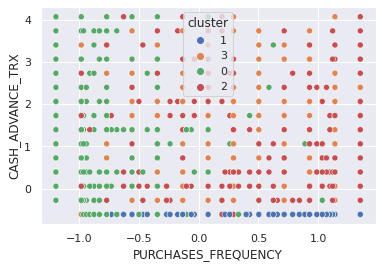

Dispersão da feature PURCHASES_FREQUENCY com PURCHASES_TRX


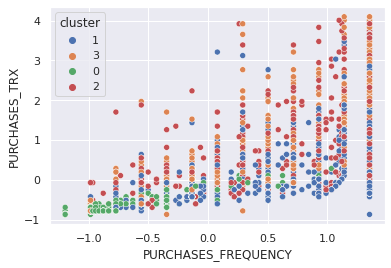

Dispersão da feature PURCHASES_FREQUENCY com CREDIT_LIMIT


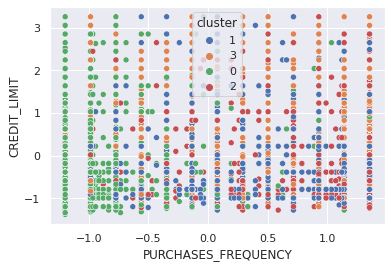

Dispersão da feature PURCHASES_FREQUENCY com PAYMENTS


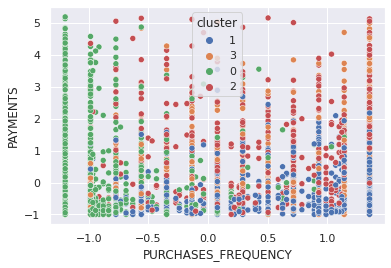

Dispersão da feature PURCHASES_FREQUENCY com MINIMUM_PAYMENTS


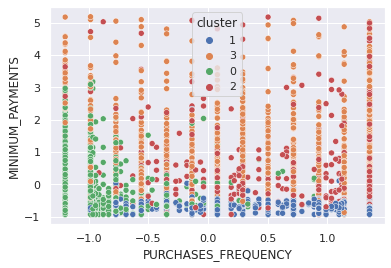

Dispersão da feature PURCHASES_FREQUENCY com PRC_FULL_PAYMENT


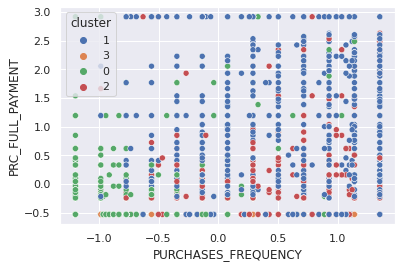

Dispersão da feature PURCHASES_FREQUENCY com TENURE


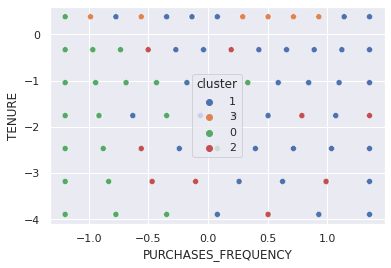

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com BALANCE


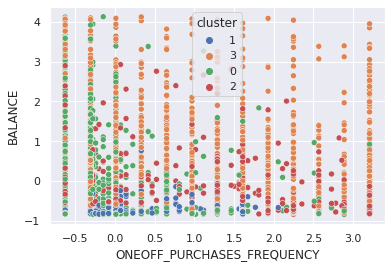

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com BALANCE_FREQUENCY


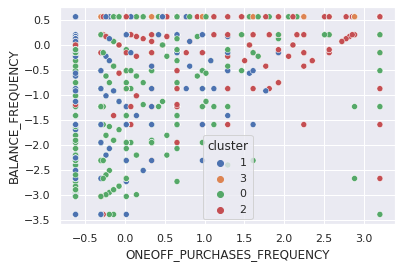

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com PURCHASES


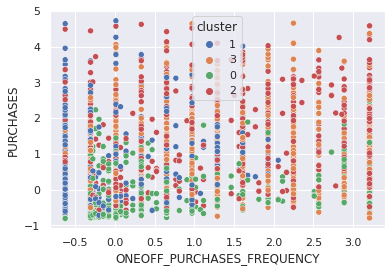

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com ONEOFF_PURCHASES


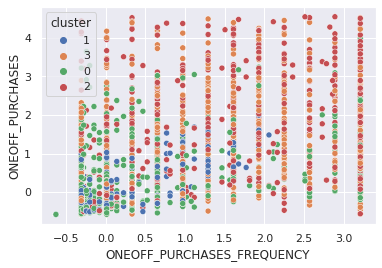

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com INSTALLMENTS_PURCHASES


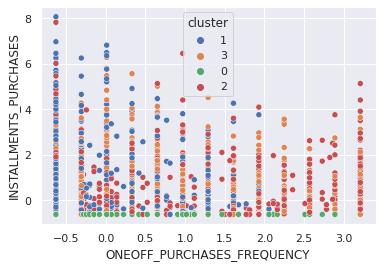

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com CASH_ADVANCE


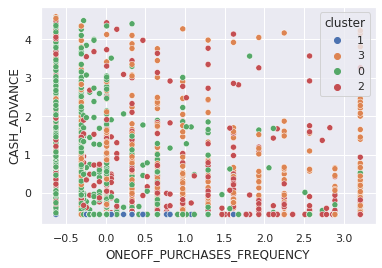

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com PURCHASES_FREQUENCY


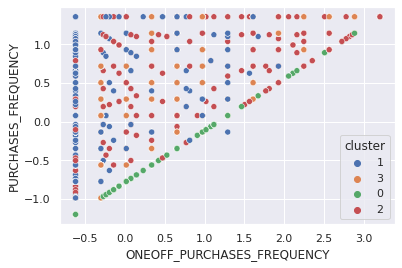

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com PURCHASES_INSTALLMENTS_FREQUENCY


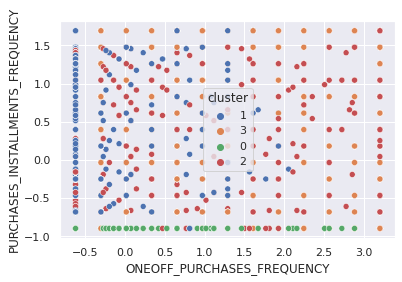

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com CASH_ADVANCE_FREQUENCY


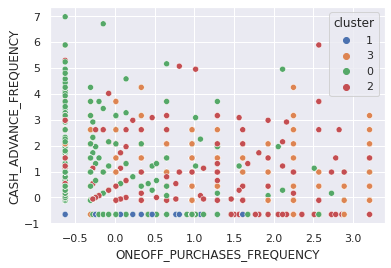

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com CASH_ADVANCE_TRX


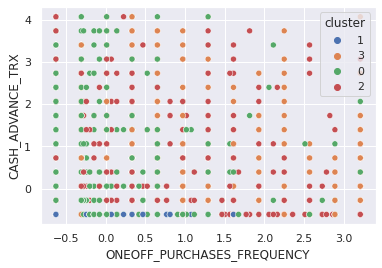

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com PURCHASES_TRX


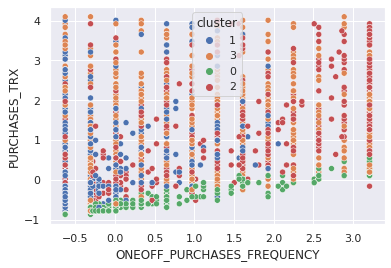

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com CREDIT_LIMIT


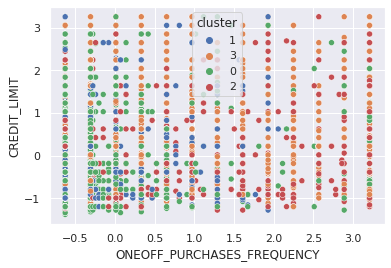

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com PAYMENTS


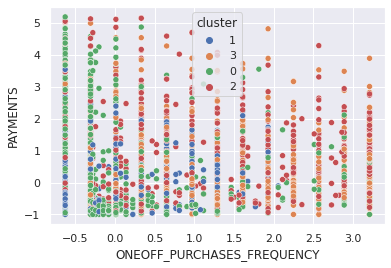

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com MINIMUM_PAYMENTS


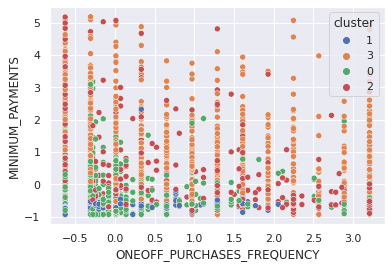

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com PRC_FULL_PAYMENT


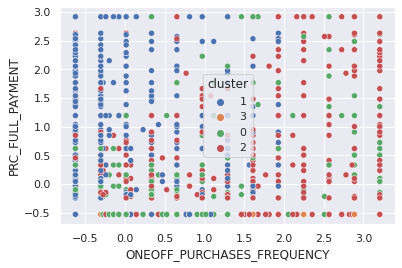

Dispersão da feature ONEOFF_PURCHASES_FREQUENCY com TENURE


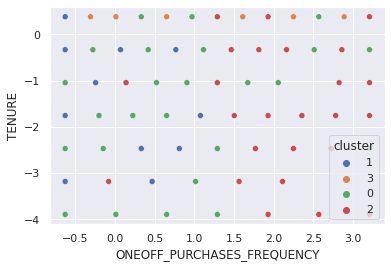

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com BALANCE


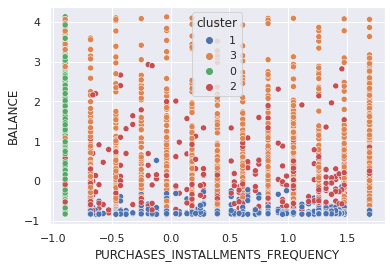

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com BALANCE_FREQUENCY


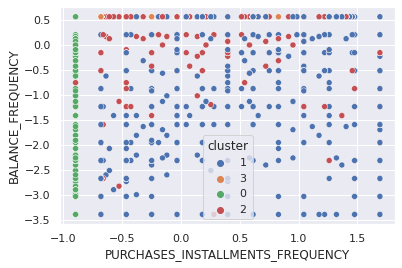

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com PURCHASES


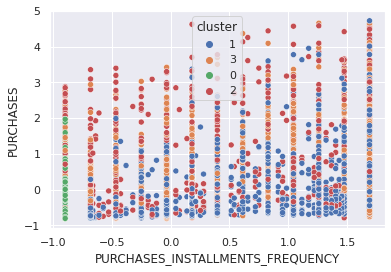

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com ONEOFF_PURCHASES


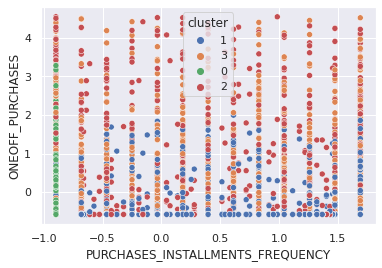

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com INSTALLMENTS_PURCHASES


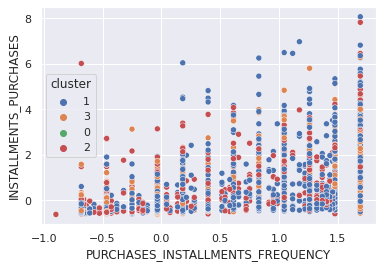

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com CASH_ADVANCE


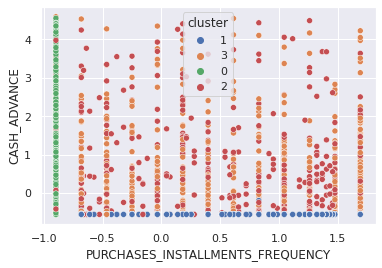

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com PURCHASES_FREQUENCY


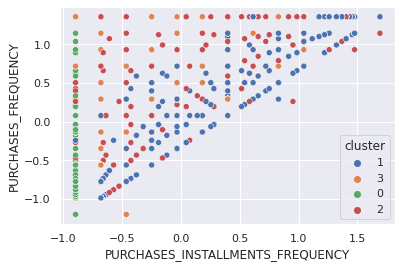

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com ONEOFF_PURCHASES_FREQUENCY


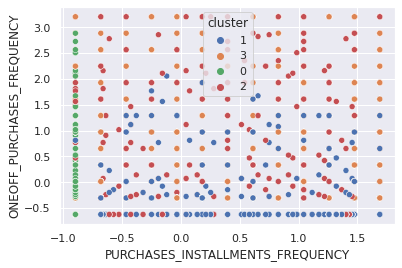

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com CASH_ADVANCE_FREQUENCY


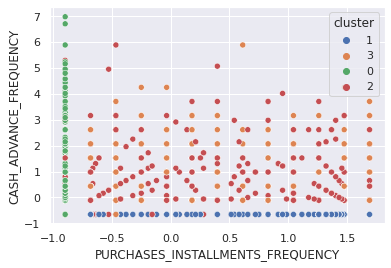

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com CASH_ADVANCE_TRX


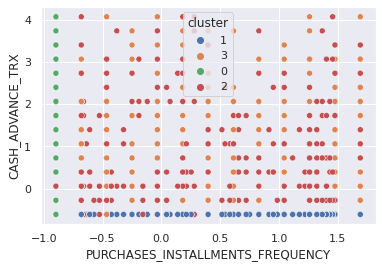

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com PURCHASES_TRX


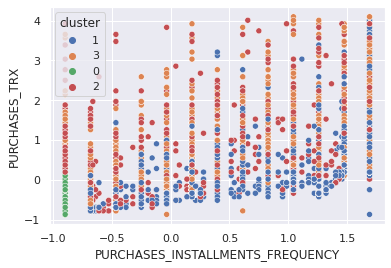

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com CREDIT_LIMIT


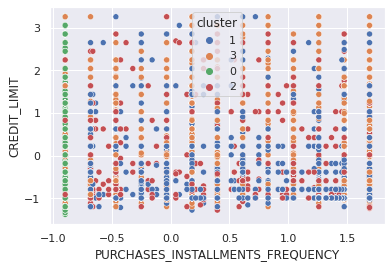

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com PAYMENTS


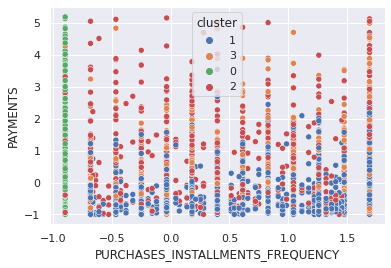

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com MINIMUM_PAYMENTS


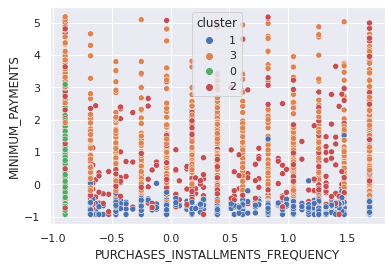

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com PRC_FULL_PAYMENT


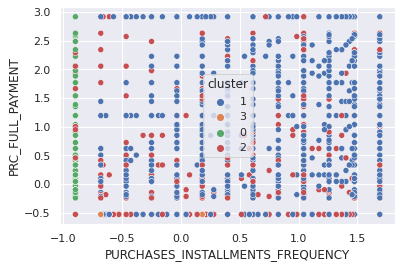

Dispersão da feature PURCHASES_INSTALLMENTS_FREQUENCY com TENURE


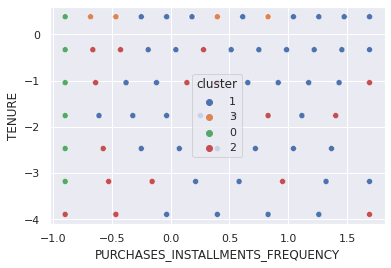

Dispersão da feature CASH_ADVANCE_FREQUENCY com BALANCE


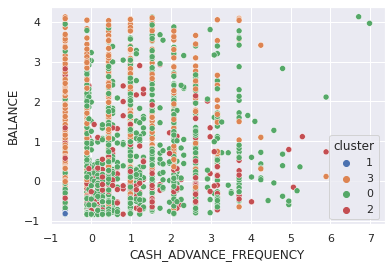

Dispersão da feature CASH_ADVANCE_FREQUENCY com BALANCE_FREQUENCY


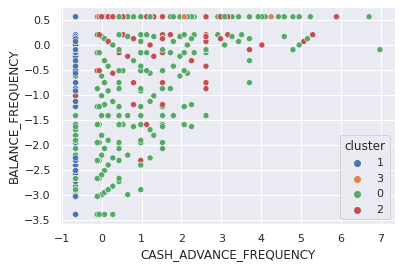

Dispersão da feature CASH_ADVANCE_FREQUENCY com PURCHASES


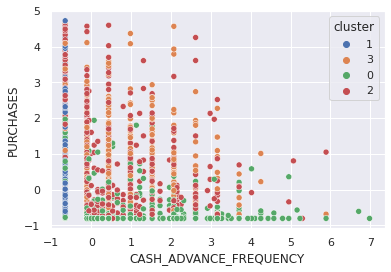

Dispersão da feature CASH_ADVANCE_FREQUENCY com ONEOFF_PURCHASES


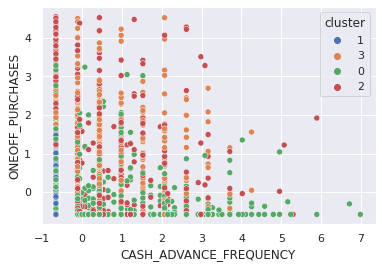

Dispersão da feature CASH_ADVANCE_FREQUENCY com INSTALLMENTS_PURCHASES


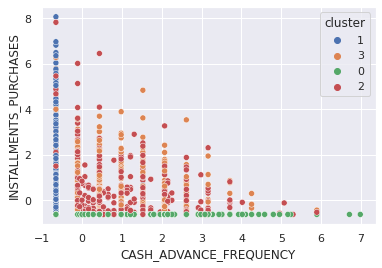

Dispersão da feature CASH_ADVANCE_FREQUENCY com CASH_ADVANCE


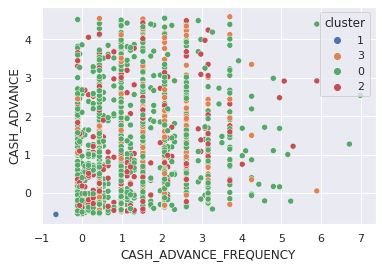

Dispersão da feature CASH_ADVANCE_FREQUENCY com PURCHASES_FREQUENCY


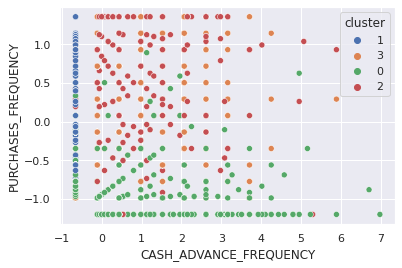

Dispersão da feature CASH_ADVANCE_FREQUENCY com ONEOFF_PURCHASES_FREQUENCY


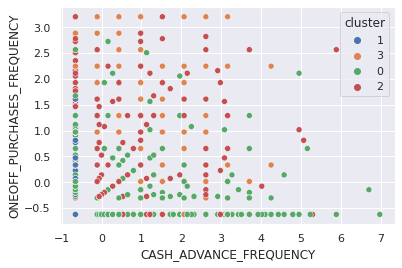

Dispersão da feature CASH_ADVANCE_FREQUENCY com PURCHASES_INSTALLMENTS_FREQUENCY


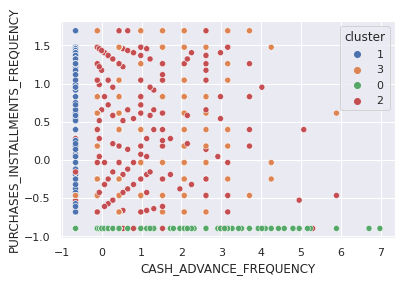

Dispersão da feature CASH_ADVANCE_FREQUENCY com CASH_ADVANCE_TRX


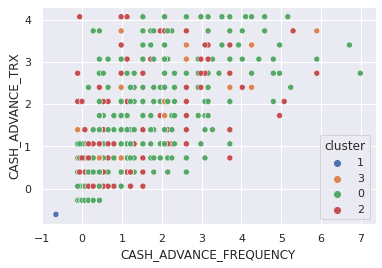

Dispersão da feature CASH_ADVANCE_FREQUENCY com PURCHASES_TRX


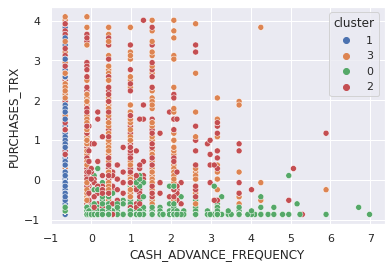

Dispersão da feature CASH_ADVANCE_FREQUENCY com CREDIT_LIMIT


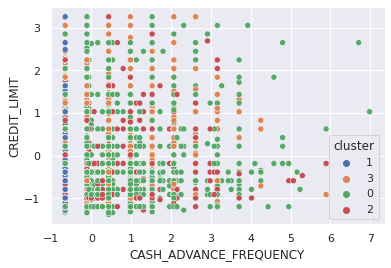

Dispersão da feature CASH_ADVANCE_FREQUENCY com PAYMENTS


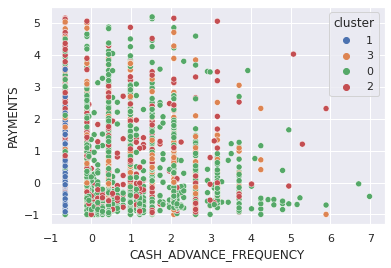

Dispersão da feature CASH_ADVANCE_FREQUENCY com MINIMUM_PAYMENTS


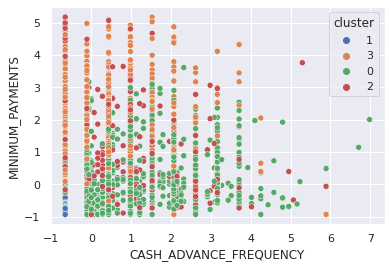

Dispersão da feature CASH_ADVANCE_FREQUENCY com PRC_FULL_PAYMENT


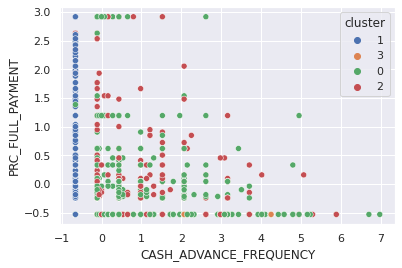

Dispersão da feature CASH_ADVANCE_FREQUENCY com TENURE


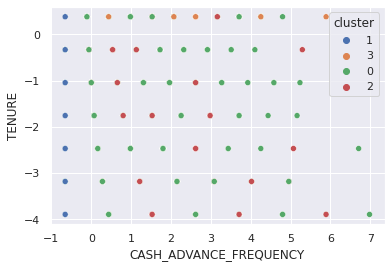

Dispersão da feature CASH_ADVANCE_TRX com BALANCE


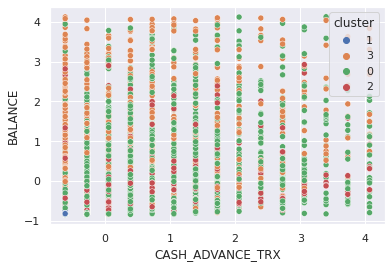

Dispersão da feature CASH_ADVANCE_TRX com BALANCE_FREQUENCY


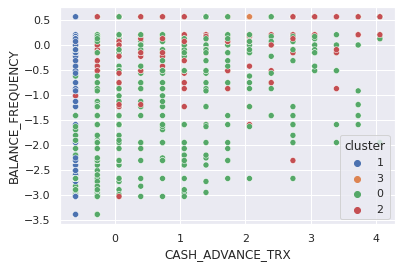

Dispersão da feature CASH_ADVANCE_TRX com PURCHASES


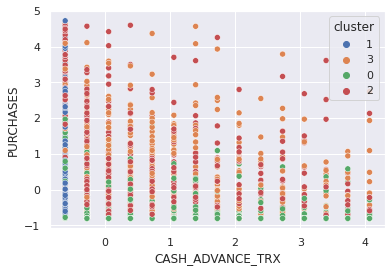

Dispersão da feature CASH_ADVANCE_TRX com ONEOFF_PURCHASES


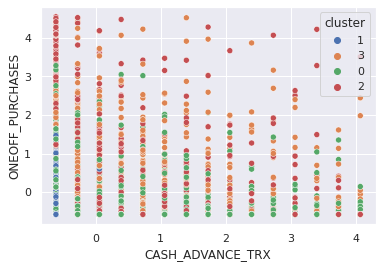

Dispersão da feature CASH_ADVANCE_TRX com INSTALLMENTS_PURCHASES


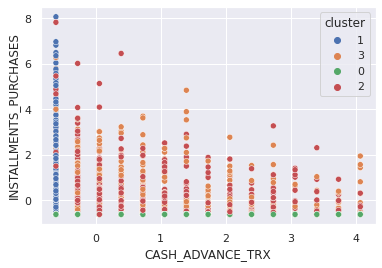

Dispersão da feature CASH_ADVANCE_TRX com CASH_ADVANCE


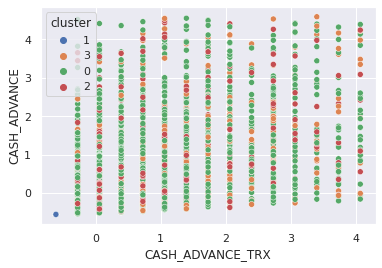

Dispersão da feature CASH_ADVANCE_TRX com PURCHASES_FREQUENCY


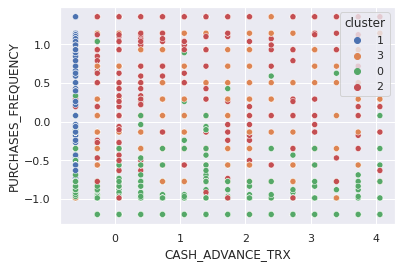

Dispersão da feature CASH_ADVANCE_TRX com ONEOFF_PURCHASES_FREQUENCY


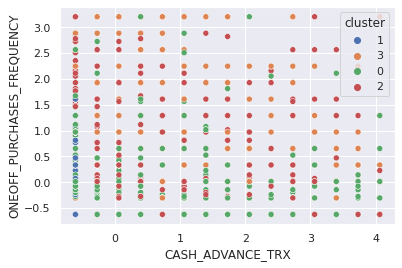

Dispersão da feature CASH_ADVANCE_TRX com PURCHASES_INSTALLMENTS_FREQUENCY


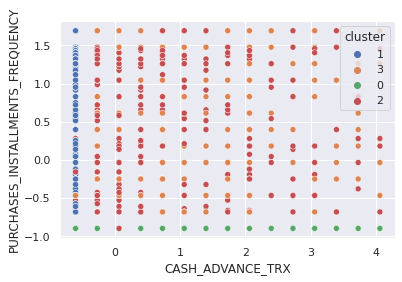

Dispersão da feature CASH_ADVANCE_TRX com CASH_ADVANCE_FREQUENCY


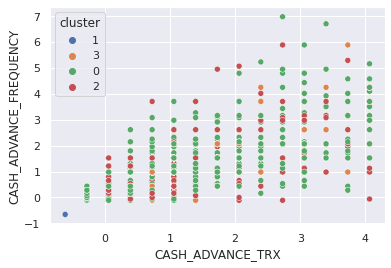

Dispersão da feature CASH_ADVANCE_TRX com PURCHASES_TRX


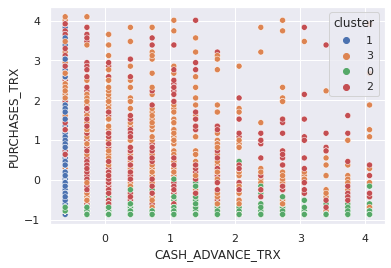

Dispersão da feature CASH_ADVANCE_TRX com CREDIT_LIMIT


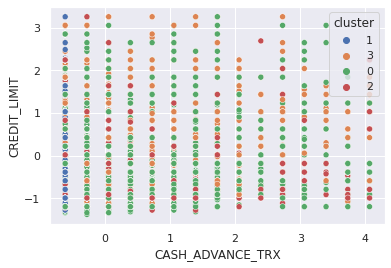

Dispersão da feature CASH_ADVANCE_TRX com PAYMENTS


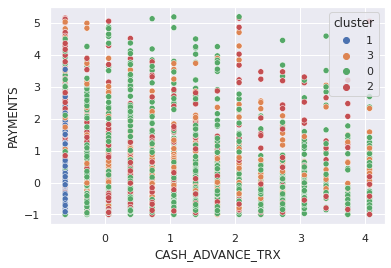

Dispersão da feature CASH_ADVANCE_TRX com MINIMUM_PAYMENTS


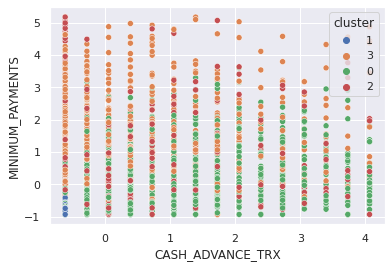

Dispersão da feature CASH_ADVANCE_TRX com PRC_FULL_PAYMENT


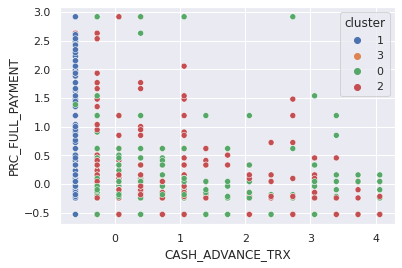

Dispersão da feature CASH_ADVANCE_TRX com TENURE


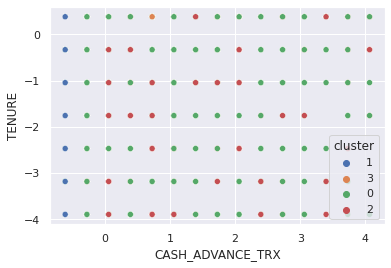

Dispersão da feature PURCHASES_TRX com BALANCE


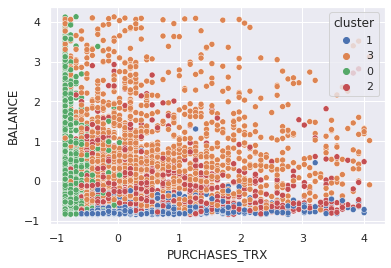

Dispersão da feature PURCHASES_TRX com BALANCE_FREQUENCY


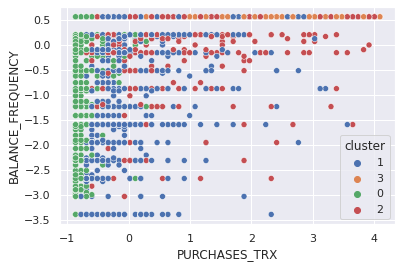

Dispersão da feature PURCHASES_TRX com PURCHASES


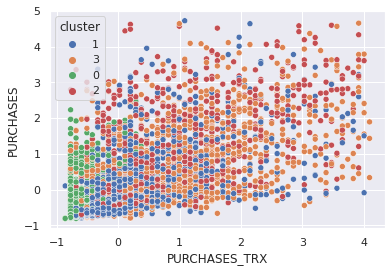

Dispersão da feature PURCHASES_TRX com ONEOFF_PURCHASES


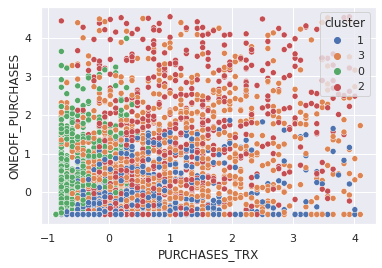

Dispersão da feature PURCHASES_TRX com INSTALLMENTS_PURCHASES


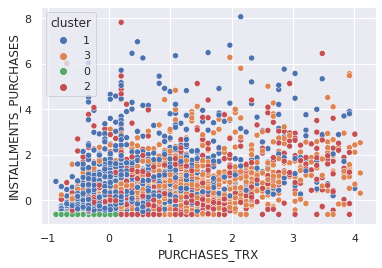

Dispersão da feature PURCHASES_TRX com CASH_ADVANCE


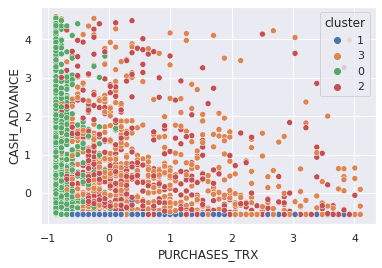

Dispersão da feature PURCHASES_TRX com PURCHASES_FREQUENCY


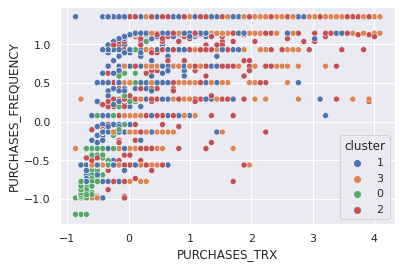

Dispersão da feature PURCHASES_TRX com ONEOFF_PURCHASES_FREQUENCY


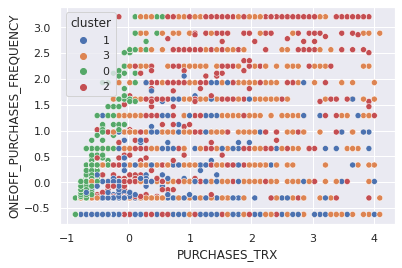

Dispersão da feature PURCHASES_TRX com PURCHASES_INSTALLMENTS_FREQUENCY


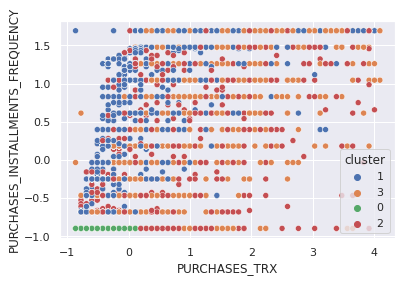

Dispersão da feature PURCHASES_TRX com CASH_ADVANCE_FREQUENCY


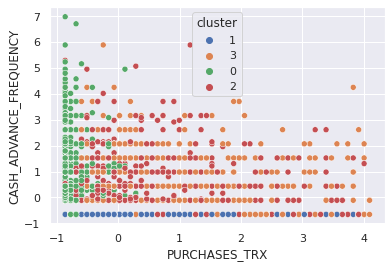

Dispersão da feature PURCHASES_TRX com CASH_ADVANCE_TRX


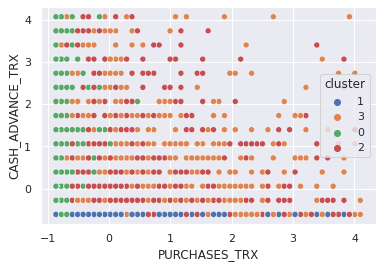

Dispersão da feature PURCHASES_TRX com CREDIT_LIMIT


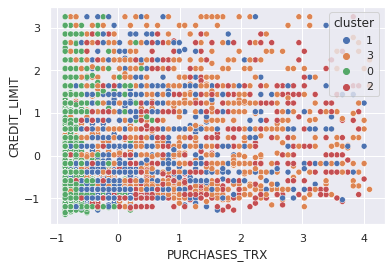

Dispersão da feature PURCHASES_TRX com PAYMENTS


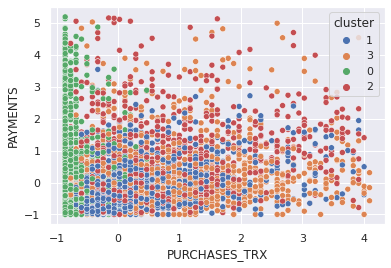

Dispersão da feature PURCHASES_TRX com MINIMUM_PAYMENTS


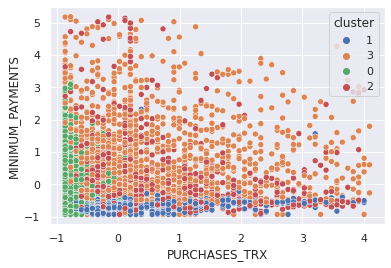

Dispersão da feature PURCHASES_TRX com PRC_FULL_PAYMENT


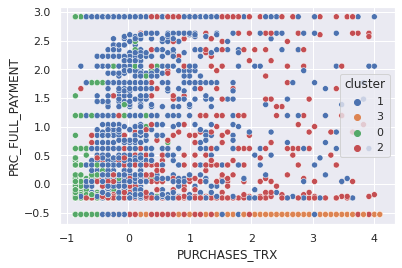

Dispersão da feature PURCHASES_TRX com TENURE


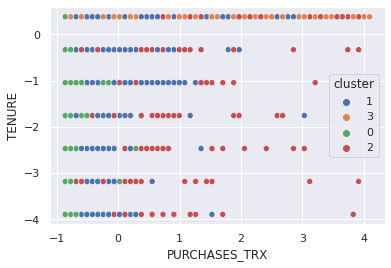

Dispersão da feature CREDIT_LIMIT com BALANCE


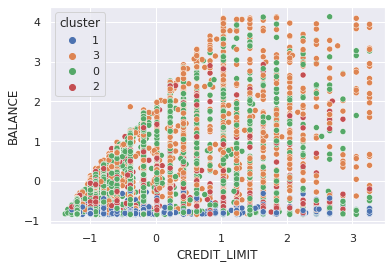

Dispersão da feature CREDIT_LIMIT com BALANCE_FREQUENCY


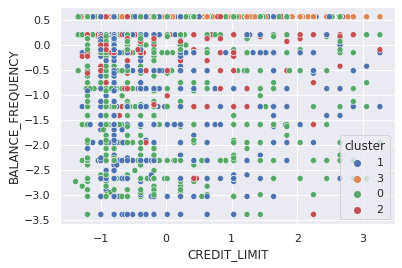

Dispersão da feature CREDIT_LIMIT com PURCHASES


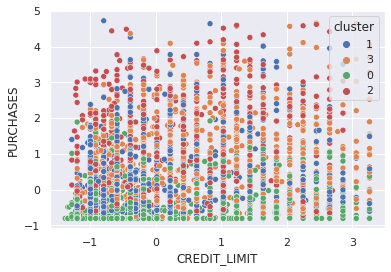

Dispersão da feature CREDIT_LIMIT com ONEOFF_PURCHASES


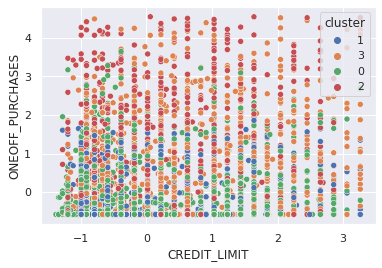

Dispersão da feature CREDIT_LIMIT com INSTALLMENTS_PURCHASES


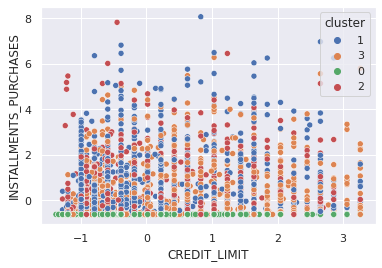

Dispersão da feature CREDIT_LIMIT com CASH_ADVANCE


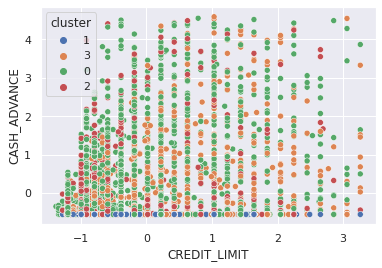

Dispersão da feature CREDIT_LIMIT com PURCHASES_FREQUENCY


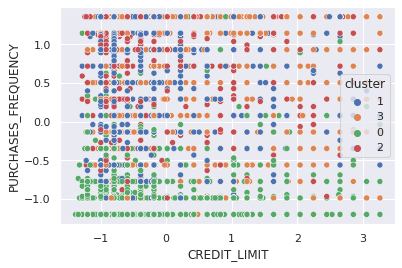

Dispersão da feature CREDIT_LIMIT com ONEOFF_PURCHASES_FREQUENCY


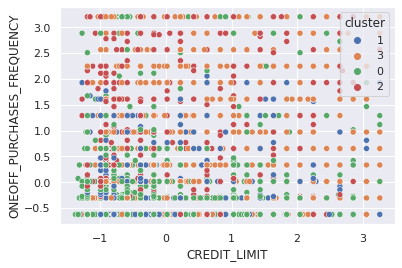

Dispersão da feature CREDIT_LIMIT com PURCHASES_INSTALLMENTS_FREQUENCY


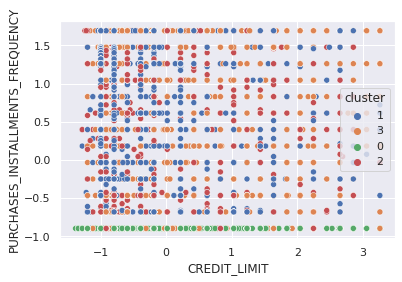

Dispersão da feature CREDIT_LIMIT com CASH_ADVANCE_FREQUENCY


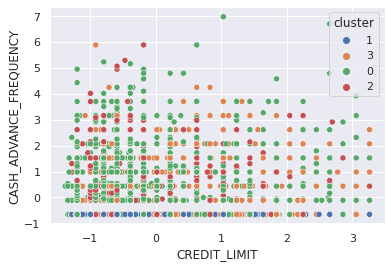

Dispersão da feature CREDIT_LIMIT com CASH_ADVANCE_TRX


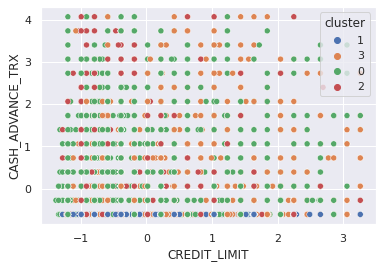

Dispersão da feature CREDIT_LIMIT com PURCHASES_TRX


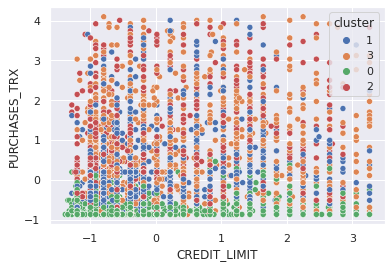

Dispersão da feature CREDIT_LIMIT com PAYMENTS


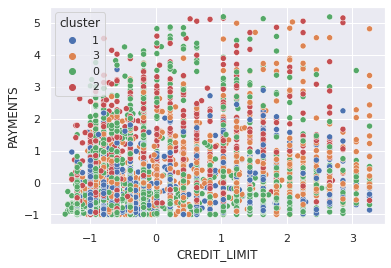

Dispersão da feature CREDIT_LIMIT com MINIMUM_PAYMENTS


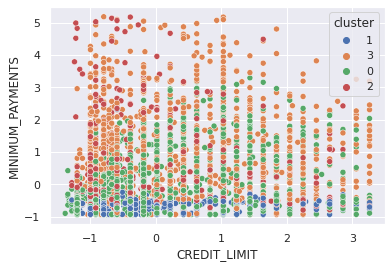

Dispersão da feature CREDIT_LIMIT com PRC_FULL_PAYMENT


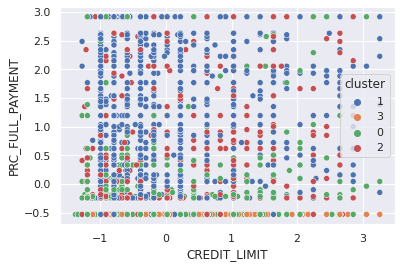

Dispersão da feature CREDIT_LIMIT com TENURE


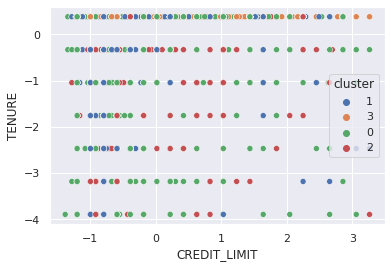

Dispersão da feature PAYMENTS com BALANCE


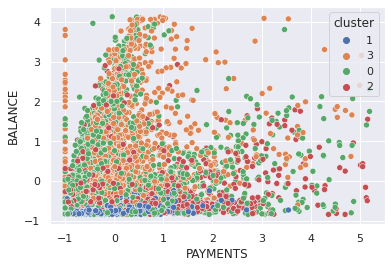

Dispersão da feature PAYMENTS com BALANCE_FREQUENCY


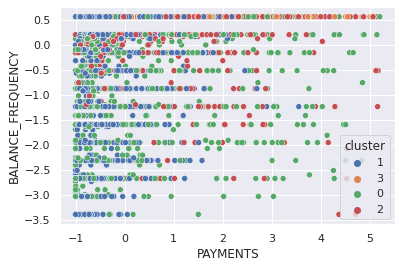

Dispersão da feature PAYMENTS com PURCHASES


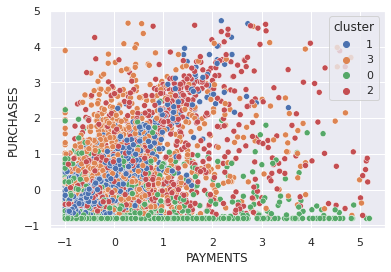

Dispersão da feature PAYMENTS com ONEOFF_PURCHASES


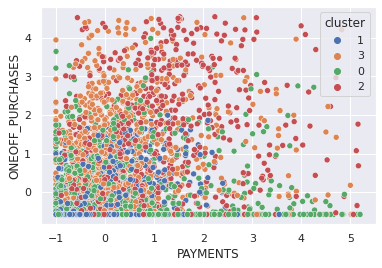

Dispersão da feature PAYMENTS com INSTALLMENTS_PURCHASES


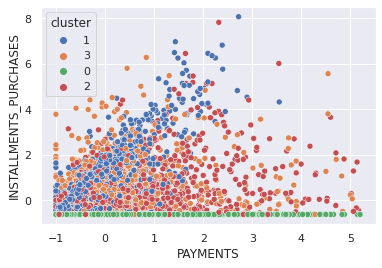

Dispersão da feature PAYMENTS com CASH_ADVANCE


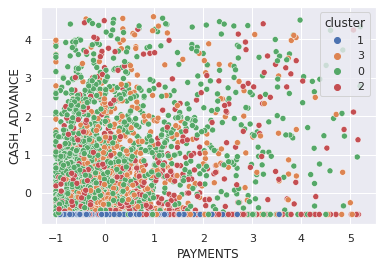

Dispersão da feature PAYMENTS com PURCHASES_FREQUENCY


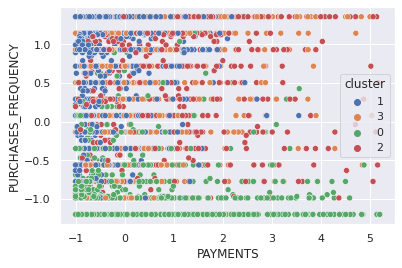

Dispersão da feature PAYMENTS com ONEOFF_PURCHASES_FREQUENCY


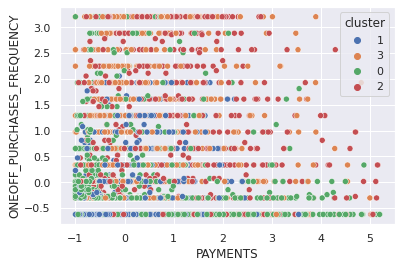

Dispersão da feature PAYMENTS com PURCHASES_INSTALLMENTS_FREQUENCY


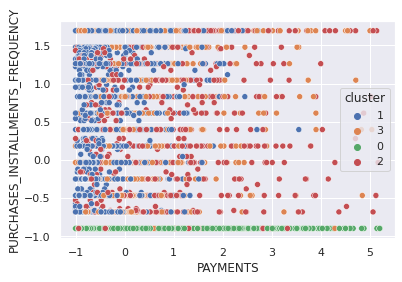

Dispersão da feature PAYMENTS com CASH_ADVANCE_FREQUENCY


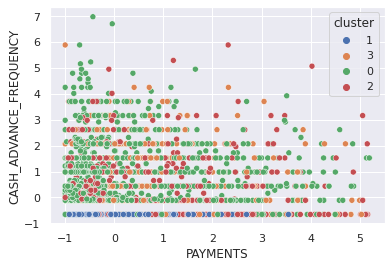

Dispersão da feature PAYMENTS com CASH_ADVANCE_TRX


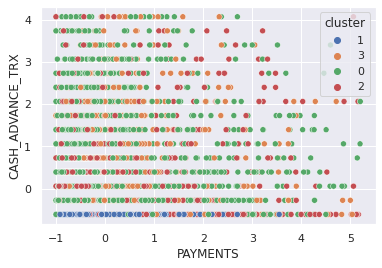

Dispersão da feature PAYMENTS com PURCHASES_TRX


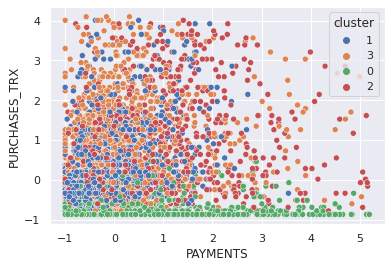

Dispersão da feature PAYMENTS com CREDIT_LIMIT


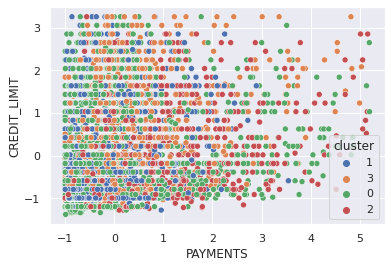

Dispersão da feature PAYMENTS com MINIMUM_PAYMENTS


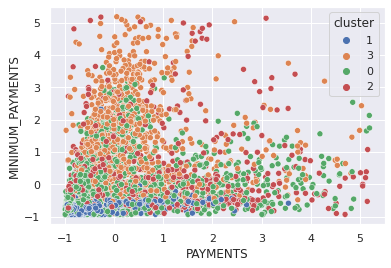

Dispersão da feature PAYMENTS com PRC_FULL_PAYMENT


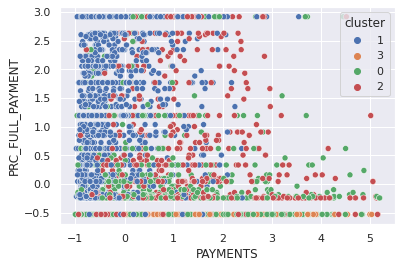

Dispersão da feature PAYMENTS com TENURE


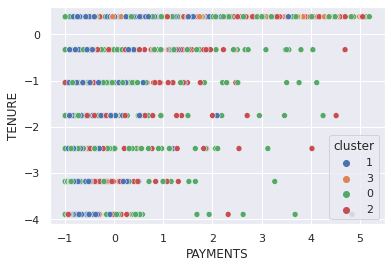

Dispersão da feature MINIMUM_PAYMENTS com BALANCE


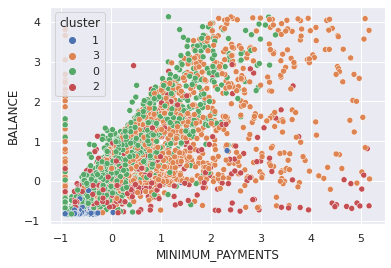

Dispersão da feature MINIMUM_PAYMENTS com BALANCE_FREQUENCY


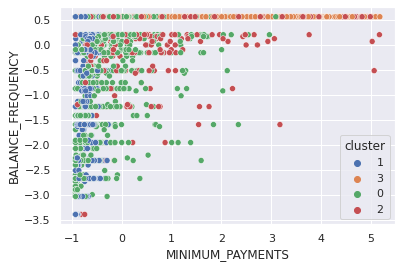

Dispersão da feature MINIMUM_PAYMENTS com PURCHASES


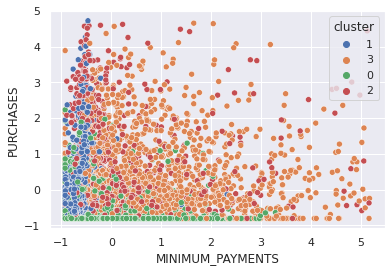

Dispersão da feature MINIMUM_PAYMENTS com ONEOFF_PURCHASES


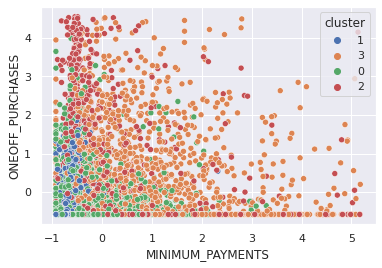

Dispersão da feature MINIMUM_PAYMENTS com INSTALLMENTS_PURCHASES


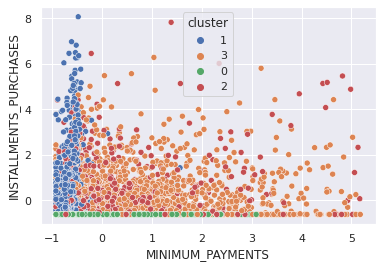

Dispersão da feature MINIMUM_PAYMENTS com CASH_ADVANCE


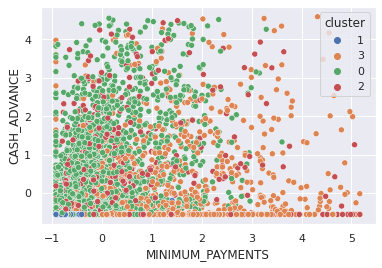

Dispersão da feature MINIMUM_PAYMENTS com PURCHASES_FREQUENCY


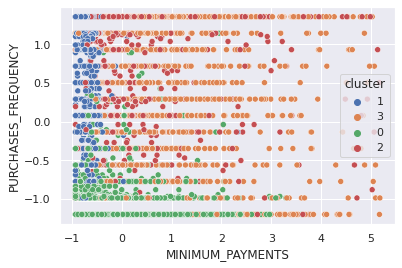

Dispersão da feature MINIMUM_PAYMENTS com ONEOFF_PURCHASES_FREQUENCY


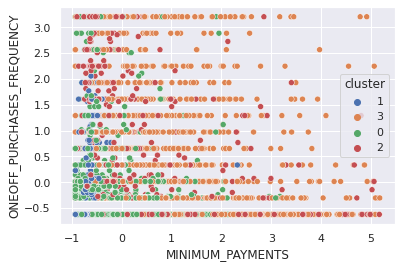

Dispersão da feature MINIMUM_PAYMENTS com PURCHASES_INSTALLMENTS_FREQUENCY


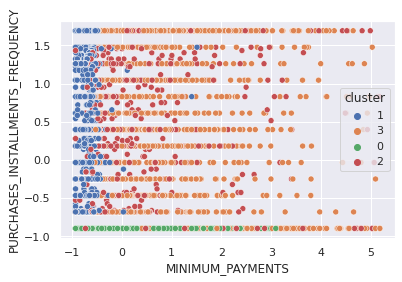

Dispersão da feature MINIMUM_PAYMENTS com CASH_ADVANCE_FREQUENCY


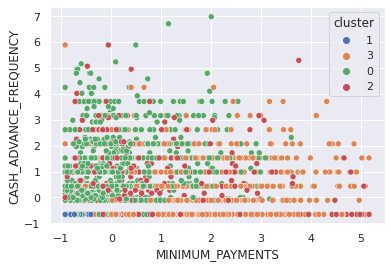

Dispersão da feature MINIMUM_PAYMENTS com CASH_ADVANCE_TRX


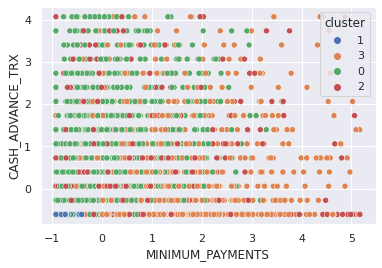

Dispersão da feature MINIMUM_PAYMENTS com PURCHASES_TRX


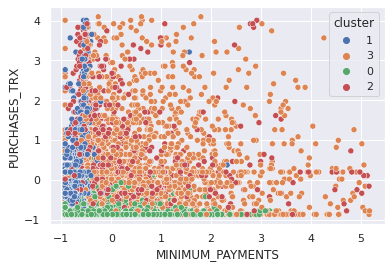

Dispersão da feature MINIMUM_PAYMENTS com CREDIT_LIMIT


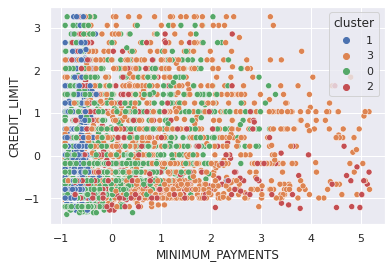

Dispersão da feature MINIMUM_PAYMENTS com PAYMENTS


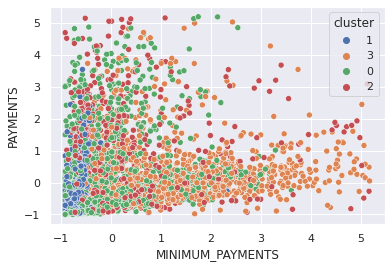

Dispersão da feature MINIMUM_PAYMENTS com PRC_FULL_PAYMENT


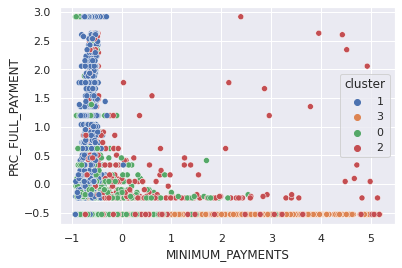

Dispersão da feature MINIMUM_PAYMENTS com TENURE


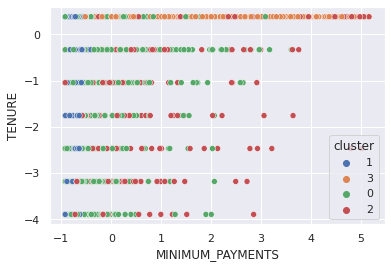

Dispersão da feature PRC_FULL_PAYMENT com BALANCE


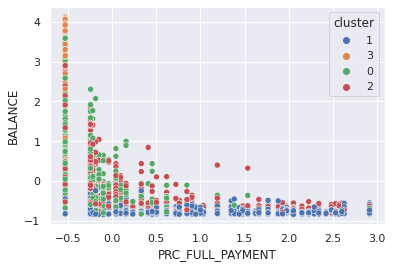

Dispersão da feature PRC_FULL_PAYMENT com BALANCE_FREQUENCY


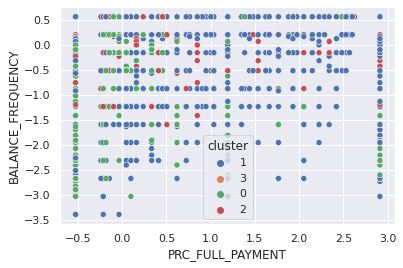

Dispersão da feature PRC_FULL_PAYMENT com PURCHASES


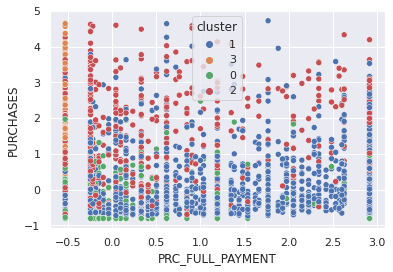

Dispersão da feature PRC_FULL_PAYMENT com ONEOFF_PURCHASES


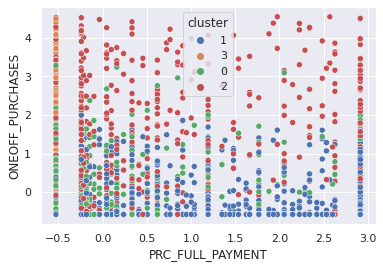

Dispersão da feature PRC_FULL_PAYMENT com INSTALLMENTS_PURCHASES


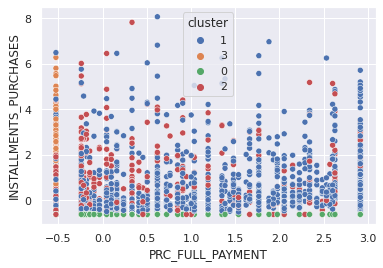

Dispersão da feature PRC_FULL_PAYMENT com CASH_ADVANCE


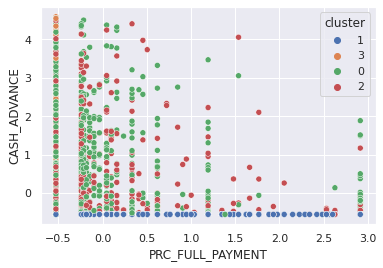

Dispersão da feature PRC_FULL_PAYMENT com PURCHASES_FREQUENCY


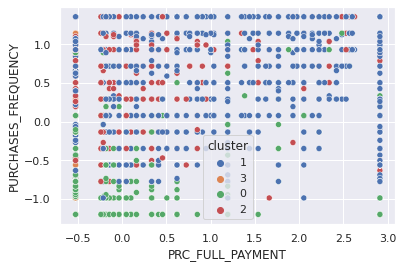

Dispersão da feature PRC_FULL_PAYMENT com ONEOFF_PURCHASES_FREQUENCY


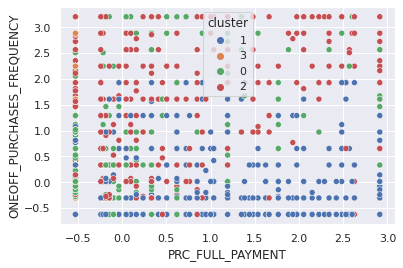

Dispersão da feature PRC_FULL_PAYMENT com PURCHASES_INSTALLMENTS_FREQUENCY


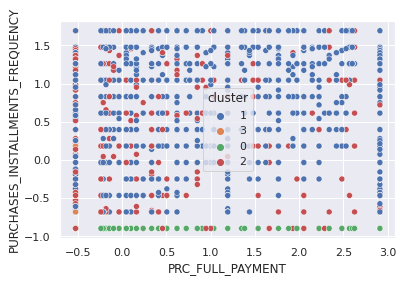

Dispersão da feature PRC_FULL_PAYMENT com CASH_ADVANCE_FREQUENCY


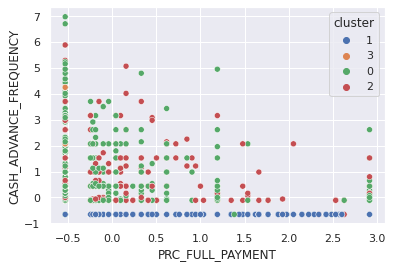

Dispersão da feature PRC_FULL_PAYMENT com CASH_ADVANCE_TRX


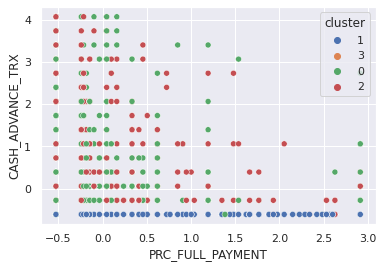

Dispersão da feature PRC_FULL_PAYMENT com PURCHASES_TRX


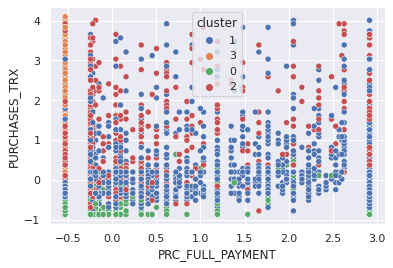

Dispersão da feature PRC_FULL_PAYMENT com CREDIT_LIMIT


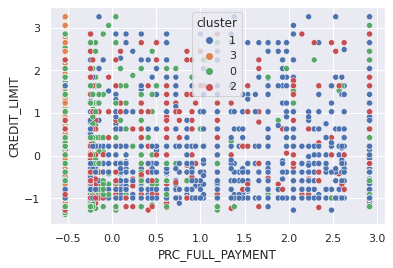

Dispersão da feature PRC_FULL_PAYMENT com PAYMENTS


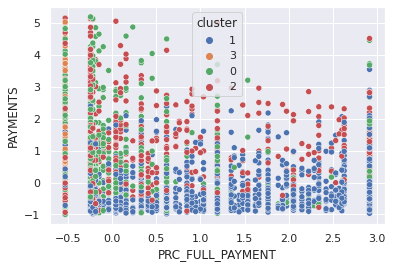

Dispersão da feature PRC_FULL_PAYMENT com MINIMUM_PAYMENTS


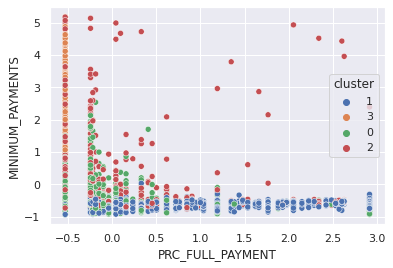

Dispersão da feature PRC_FULL_PAYMENT com TENURE


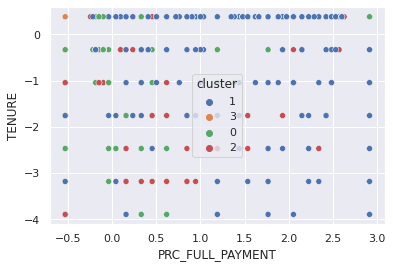

Dispersão da feature TENURE com BALANCE


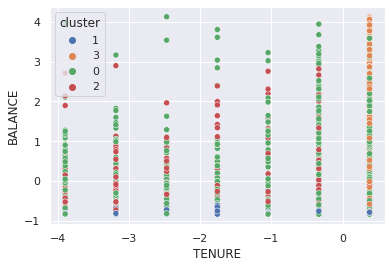

Dispersão da feature TENURE com BALANCE_FREQUENCY


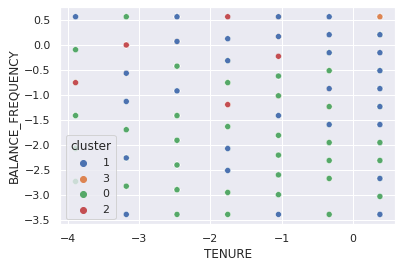

Dispersão da feature TENURE com PURCHASES


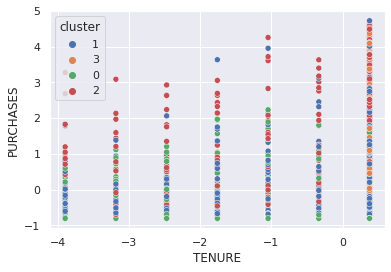

Dispersão da feature TENURE com ONEOFF_PURCHASES


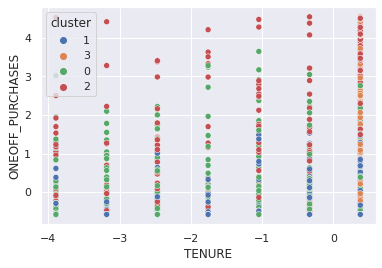

Dispersão da feature TENURE com INSTALLMENTS_PURCHASES


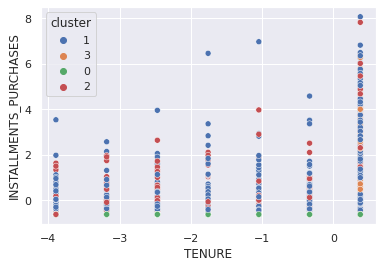

Dispersão da feature TENURE com CASH_ADVANCE


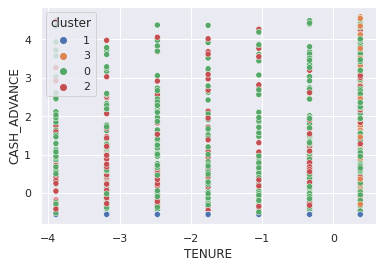

Dispersão da feature TENURE com PURCHASES_FREQUENCY


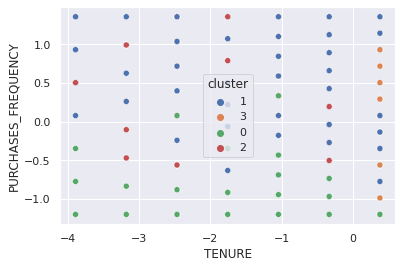

Dispersão da feature TENURE com ONEOFF_PURCHASES_FREQUENCY


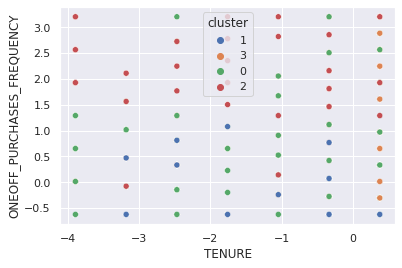

Dispersão da feature TENURE com PURCHASES_INSTALLMENTS_FREQUENCY


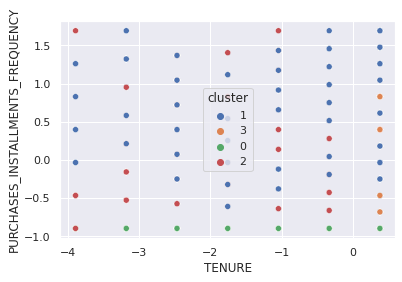

Dispersão da feature TENURE com CASH_ADVANCE_FREQUENCY


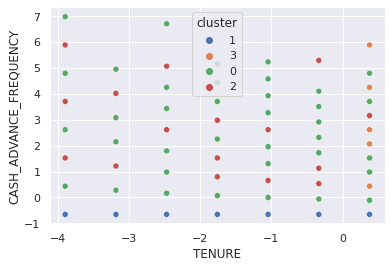

Dispersão da feature TENURE com CASH_ADVANCE_TRX


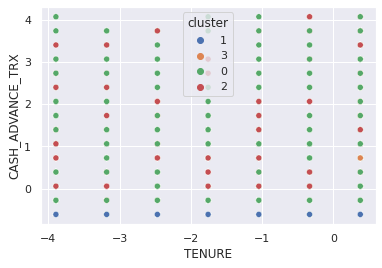

Dispersão da feature TENURE com PURCHASES_TRX


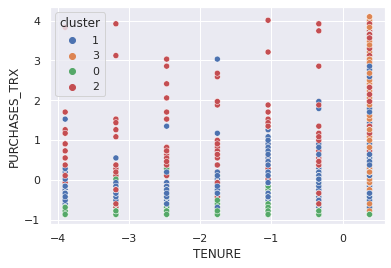

Dispersão da feature TENURE com CREDIT_LIMIT


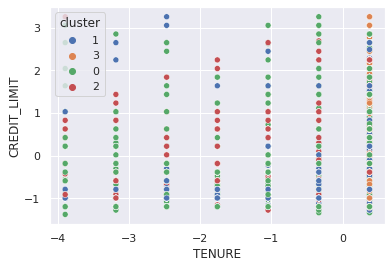

Dispersão da feature TENURE com PAYMENTS


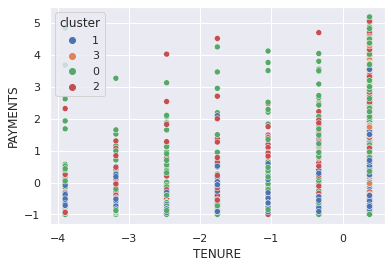

Dispersão da feature TENURE com MINIMUM_PAYMENTS


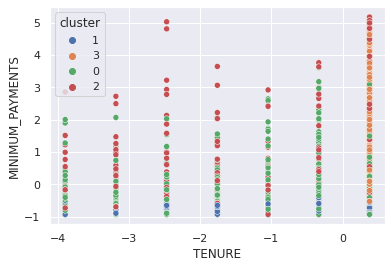

Dispersão da feature TENURE com PRC_FULL_PAYMENT


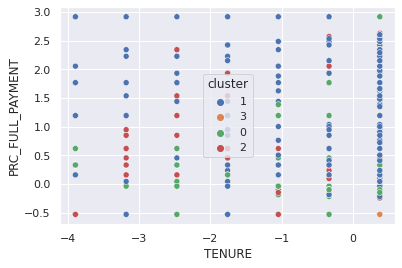

In [24]:
for i in range(0,n):
  for j in range(0,n):
    if(i!=j):
      print('Dispersão da feature %s com %s'%(features[i],features[j]))
      sns.scatterplot(x =features[i], y= features[j], hue = 'cluster', data= df)      
      plt.show()

#4. Aplicação do modelo de regressão

In [25]:
df_regressor = df.copy()

In [26]:
df_regressor = pd.get_dummies(df_regressor,columns=['cluster'])

In [27]:
df_regressor.sample(10)

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster_0,cluster_1,cluster_2,cluster_3
956,-0.834638,0.203171,-0.363904,-0.290514,-0.248270,-0.554374,1.141552,2.248048,0.828440,-0.654668,-0.608844,1.792630,1.031740,-0.687428,-0.862102,-0.528461,0.378142,0,0,1,0
1166,0.625603,0.563133,-0.419792,-0.580259,-0.005850,-0.554374,1.354168,-0.624223,1.690889,-0.654668,-0.608844,0.464699,-0.671740,-0.314870,0.430081,-0.528461,0.378142,0,0,0,1
4129,-0.691828,0.563133,2.056956,2.231042,0.725456,-0.554374,1.354168,3.205472,1.690889,-0.654668,-0.608844,2.589389,1.640126,0.963555,-0.519137,2.053400,0.378142,0,0,1,0
3434,0.211646,0.563133,-0.466554,-0.110778,-0.617526,-0.554374,-0.346768,0.652341,-0.896459,-0.654668,-0.608844,-0.066474,-0.915094,-0.457145,1.146561,-0.528461,0.378142,0,0,0,1
4325,0.127232,0.563133,-0.194631,-0.370731,0.113316,-0.554374,0.890277,0.072084,0.985249,-0.654668,-0.608844,0.464699,-0.915094,0.514620,0.464363,-0.528461,-0.333655,0,0,1,0
4187,-0.819704,-2.316567,-0.349550,-0.580259,0.106110,-0.554374,-0.346768,-0.624223,-0.034011,-0.654668,-0.608844,0.110584,1.234535,0.468184,-0.615744,2.914020,0.378142,0,1,0,0
893,-0.678439,0.563133,1.702505,1.288159,1.239254,-0.554374,1.354168,0.971484,1.475277,-0.654668,-0.608844,0.818814,2.654102,0.724879,-0.530145,2.914020,0.378142,0,1,0,0
982,0.701515,0.563133,0.219452,0.844934,-0.617526,1.420740,-0.559384,0.333201,-0.896459,2.072281,3.731583,-0.420589,-0.590622,1.399547,0.963307,-0.528461,0.378142,1,0,0,0
6415,-0.831328,-2.676529,-0.733291,-0.580259,-0.505545,-0.554374,-0.772000,-0.624223,-0.680848,-0.654668,-0.608844,-0.686175,-0.185031,-0.999977,-0.926355,-0.528461,0.378142,0,1,0,0
2928,2.312983,0.563133,-0.803546,-0.580259,-0.617526,-0.440599,-1.197235,-0.624223,-0.896459,-0.059698,-0.274965,-0.863232,1.842921,0.413325,1.177378,-0.528461,-0.333655,1,0,0,0


Aqui é separado as variáveis X do *target* y='CREDIT_LIMIT', e separados em datasets de teste e treino

In [28]:
y = df_regressor['CREDIT_LIMIT']
X = df_regressor.drop('CREDIT_LIMIT',axis=1)

In [29]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3,random_state=42)
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(4816, 20)
(2064, 20)
(4816,)
(2064,)


Aplicação de um MLP (Multi-layer Perceptron)para a regressão (https://scikit-learn.org/stable/modules/generated/sklearn.neural_network.MLPRegressor.html)

In [30]:
reg  = MLPRegressor(max_iter=500)
reg.fit(X_train,y_train)
y_pred = reg.predict(X_test)

Abaixo seguem os scores para a regressão ao comparar com o y predito e o y de teste

In [31]:
print("MAE = {}".format(mean_absolute_error(y_test,y_pred)))
print("RMSE = {}".format(mean_squared_error(y_test,y_pred, squared=False)))
print("R² = {}".format(r2_score(y_test,y_pred)))

MAE = 0.6201281503903673
RMSE = 0.82376296056732
R² = 0.3143462778001267


Será feita uma Hiperparametrização na tentativa de melhorar esses scores utilizando o GridSearchCV, variando diversos argumentos do regressor MLP e tentar encontrar a melhor modelagem.

(https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html)


In [32]:
reg = MLPRegressor(max_iter=500) 
parameters = {"hidden_layer_sizes": [(1,),(10,),(50,)], "activation": ["identity", "logistic", "tanh", "relu"], "solver": ["lbfgs", "sgd", "adam"], "alpha": [0.00005,0.0005]}
grid = GridSearchCV(reg, parameters, scoring="neg_mean_absolute_error",verbose=0, n_jobs=-1)
grid.fit(X_train, y_train)

GridSearchCV(estimator=MLPRegressor(max_iter=500), n_jobs=-1,
             param_grid={'activation': ['identity', 'logistic', 'tanh', 'relu'],
                         'alpha': [5e-05, 0.0005],
                         'hidden_layer_sizes': [(1,), (10,), (50,)],
                         'solver': ['lbfgs', 'sgd', 'adam']},
             scoring='neg_mean_absolute_error')

In [33]:
grid.best_estimator_

MLPRegressor(activation='logistic', alpha=5e-05, hidden_layer_sizes=(50,),
             max_iter=500)

In [34]:
y_grid = grid.predict(X_test)

In [35]:
print("MAE = {}".format(mean_absolute_error(y_test,y_grid)))
print("RMSE = {}".format(mean_squared_error(y_test,y_grid, squared=False)))
print("R² = {}".format(r2_score(y_test,y_grid)))

MAE = 0.5917279597719608
RMSE = 0.7963090557455892
R² = 0.35928686690084555


A hiperparametrização melhorou os scores tornando o modelo um pouco mais confiável, porém seria interessante realizar outros tipos de filtro no dataset ou outros métodos de clusterização para melhorar os resultados.

#5. Extras

In [36]:
df0 = dff.copy()

In [37]:
df0.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0.0,2.0,1000.0,201.802084,139.509787,0.0,12
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0.0,12.0,7500.0,622.066742,627.284787,0.0,12
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1.0,1.0,7500.0,0.000000,0.019163,0.0,12
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0.0,1.0,1200.0,678.334763,244.791237,0.0,12
5,1809.828751,1.000000,1333.28,0.00,1333.28,0.000000,0.666667,0.000000,0.583333,0.000000,0.0,8.0,1800.0,1400.057770,2407.246035,0.0,12


In [38]:
df0['CREDIT_LIMIT'].describe()

count     6880.000000
mean      3456.202556
std       2465.720075
min         50.000000
25%       1500.000000
50%       2700.000000
75%       5000.000000
max      11500.000000
Name: CREDIT_LIMIT, dtype: float64

In [39]:
df1 = dff.copy()

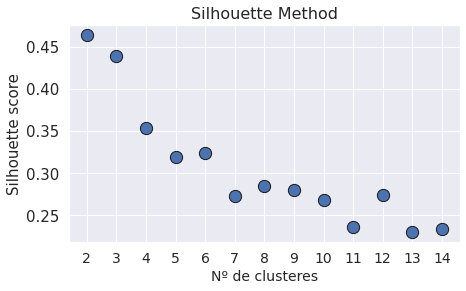

In [40]:
from sklearn.preprocessing import StandardScaler
from sklearn               import metrics
from sklearn.metrics       import silhouette_score
from sklearn.cluster       import KMeans

scaler = StandardScaler()
scaler.fit(df1[features])
df1_scaller = pd.DataFrame(scaler.transform(df1[features]),columns=features)

alvo          = df1
max           = 15
km_silhouette = []

for i in range(2,max):
  km = KMeans(n_clusters=i, random_state=0).fit(alvo)
  preds = km.predict(alvo)
  km_scores.append(-km.score(alvo))
  silhouette = silhouette_score(alvo,preds)
  km_silhouette.append(silhouette)

plt.figure(figsize=(7,4))
plt.title("Silhouette Method",fontsize=16)
plt.scatter(x=[i for i in range(2,max)],y=km_silhouette,s=150,edgecolor='k')
plt.grid(True)
plt.xlabel("Nº de clusteres",fontsize=14)
plt.ylabel("Silhouette score",fontsize=15)
plt.xticks([i for i in range(2,max)],fontsize=14)
plt.yticks(fontsize=15)
plt.show()

In [41]:
df2 = dff.copy()

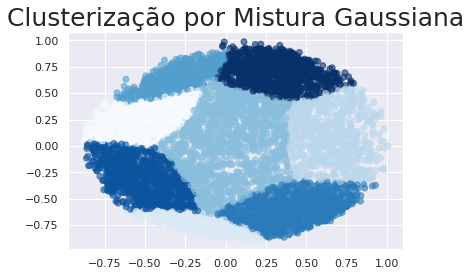

In [42]:
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA

scaler = StandardScaler()
scaler.fit(df2[features])
df2_scaller   = pd.DataFrame(scaler.transform(df2[features]),columns=features)
normalized_df = normalize(df2_scaller,axis=1)
pca           = PCA(n_components=2)
X_principal   = pca.fit_transform(normalized_df)
X_principal   = pd.DataFrame(X_principal)
X_principal.columns = ['P1', 'P2']
plt.title('Clusterização por Mistura Gaussiana',fontsize=25)
plt.scatter(X_principal['P2'],X_principal['P1'],c = GaussianMixture(n_components = 8).fit_predict(X_principal), alpha = 0.6,cmap='Blues')
plt.show()